In [1]:
#### Credit Card Churn Analysis Using Different Classifier Methods
### Source: https://www.kaggle.com/code/nivednambiar/credit-card-churn-prediction/notebook

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn
import imblearn
%matplotlib inline

In [2]:
credit_churn_dataset= pd.read_csv('credit_card_churn.csv')
credit_churn_dataset.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.99991
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.99994
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.99998
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.99987
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.99998


In [3]:
##Drop precalculated columns
credit_churn_dataset.drop(["Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1", "Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2"], axis = 1, inplace = True)

In [4]:
###Explore the Dataset
credit_churn_dataset.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


In [5]:
credit_churn_dataset.columns

Index(['CLIENTNUM', 'Attrition_Flag', 'Customer_Age', 'Gender',
       'Dependent_count', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio'],
      dtype='object')

In [6]:
X = credit_churn_dataset.drop('Attrition_Flag', axis = 1)
y = credit_churn_dataset['Attrition_Flag']

In [7]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CLIENTNUM                 10127 non-null  int64  
 1   Customer_Age              10127 non-null  int64  
 2   Gender                    10127 non-null  object 
 3   Dependent_count           10127 non-null  int64  
 4   Education_Level           10127 non-null  object 
 5   Marital_Status            10127 non-null  object 
 6   Income_Category           10127 non-null  object 
 7   Card_Category             10127 non-null  object 
 8   Months_on_book            10127 non-null  int64  
 9   Total_Relationship_Count  10127 non-null  int64  
 10  Months_Inactive_12_mon    10127 non-null  int64  
 11  Contacts_Count_12_mon     10127 non-null  int64  
 12  Credit_Limit              10127 non-null  float64
 13  Total_Revolving_Bal       10127 non-null  int64  
 14  Avg_Op

In [8]:
X.isnull().sum()

CLIENTNUM                   0
Customer_Age                0
Gender                      0
Dependent_count             0
Education_Level             0
Marital_Status              0
Income_Category             0
Card_Category               0
Months_on_book              0
Total_Relationship_Count    0
Months_Inactive_12_mon      0
Contacts_Count_12_mon       0
Credit_Limit                0
Total_Revolving_Bal         0
Avg_Open_To_Buy             0
Total_Amt_Chng_Q4_Q1        0
Total_Trans_Amt             0
Total_Trans_Ct              0
Total_Ct_Chng_Q4_Q1         0
Avg_Utilization_Ratio       0
dtype: int64

In [9]:
y.isnull().sum()

0

In [10]:
X.describe()

,CLIENTNUM,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
count,1.012700e+04,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000
mean,7.391776e+08,46.325960,2.346203,35.928409,3.812580,2.341167,2.455317,8631.953698,1162.814061,7469.139637,0.759941,4404.086304,64.858695,0.712222,0.274894
std,3.690378e+07,8.016814,1.298908,7.986416,1.554408,1.010622,1.106225,9088.776650,814.987335,9090.685324,0.219207,3397.129254,23.472570,0.238086,0.275691
min,7.080821e+08,26.000000,0.000000,13.000000,1.000000,0.000000,0.000000,1438.300000,0.000000,3.000000,0.000000,510.000000,10.000000,0.000000,0.000000
25%,7.130368e+08,41.000000,1.000000,31.000000,3.000000,2.000000,2.000000,2555.000000,359.000000,1324.500000,0.631000,2155.500000,45.000000,0.582000,0.023000
50%,7.179264e+08,46.000000,2.000000,36.000000,4.000000,2.000000,2.000000,4549.000000,1276.000000,3474.000000,0.736000,3899.000000,67.000000,0.702000,0.176000
75%,7.731435e+08,52.000000,3.000000,40.000000,5.000000,3.000000,3.000000,11067.500000,1784.000000,9859.000000,0.859000,4741.000000,81.000000,0.818000,0.503000
max,8.283431e+08,73.000000,5.000000,56.000000,6.000000,6.000000,6.000000,34516.000000,2517.000000,34516.000000,3.397000,18484.000000,139.000000,3.714000,0.999000


<Axes: xlabel='Attrition_Flag', ylabel='count'>

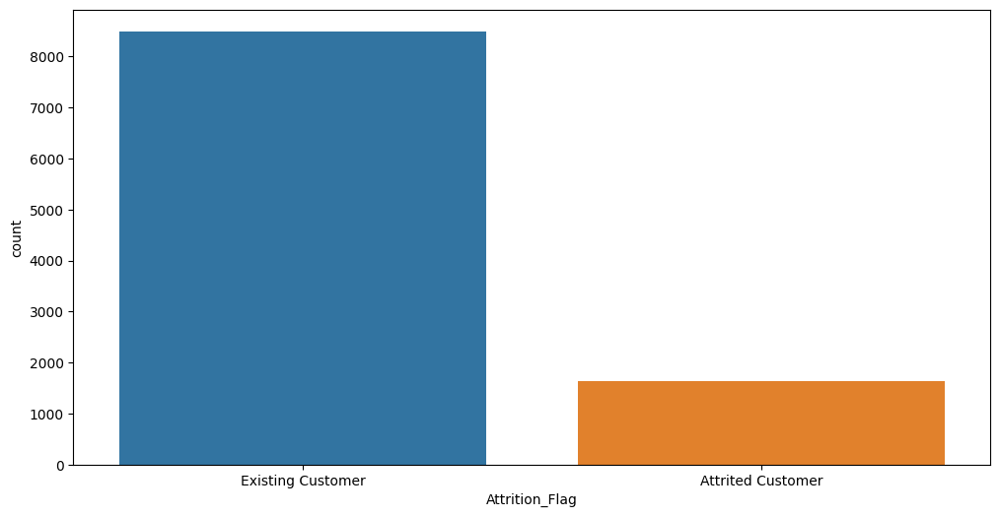

In [11]:
fig, axes = plt.subplots(1,1,figsize = (12,6))
sns.countplot(data = credit_churn_dataset, x = 'Attrition_Flag' )

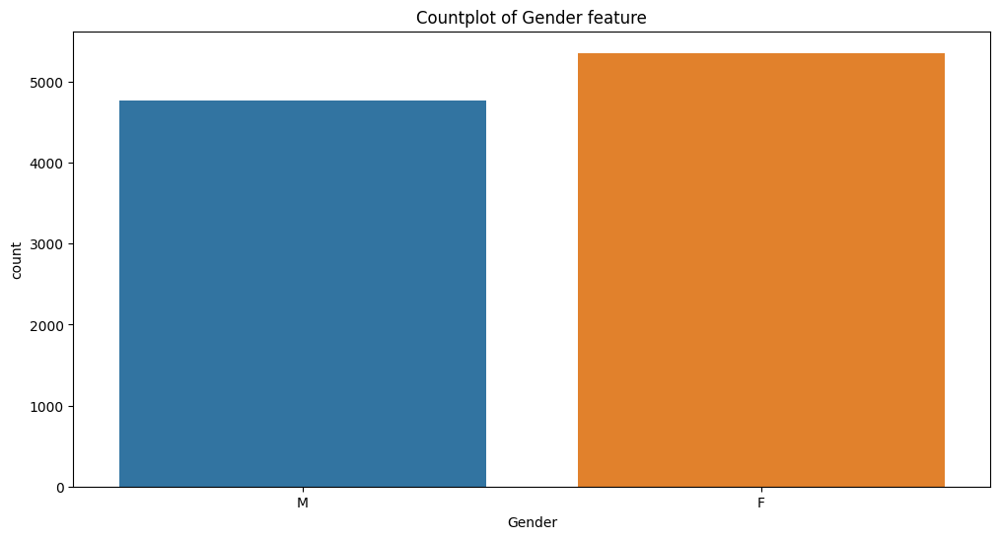

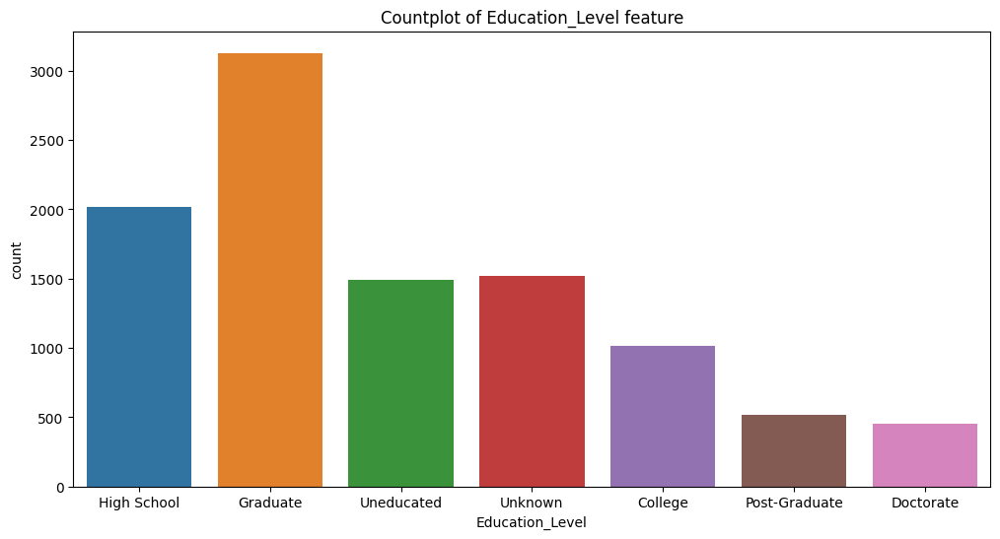

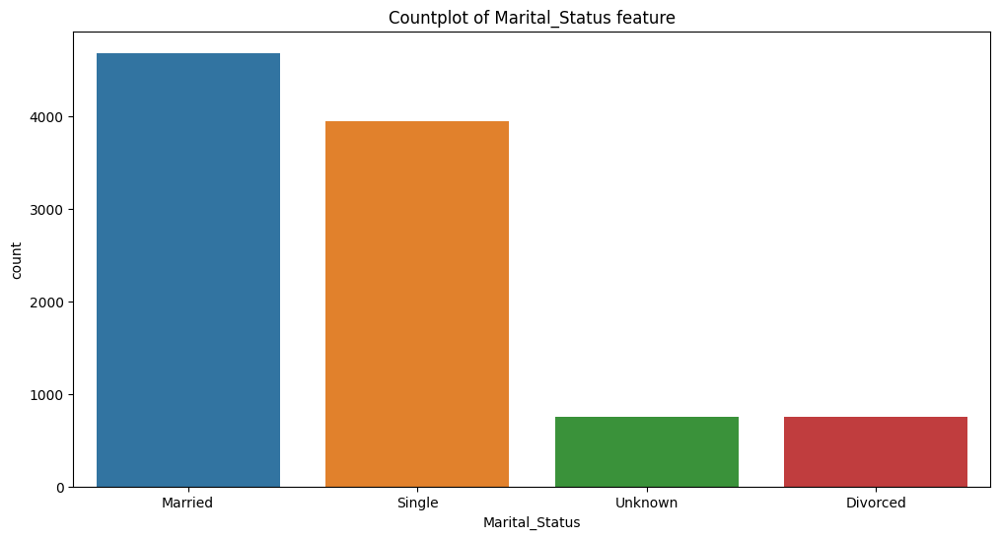

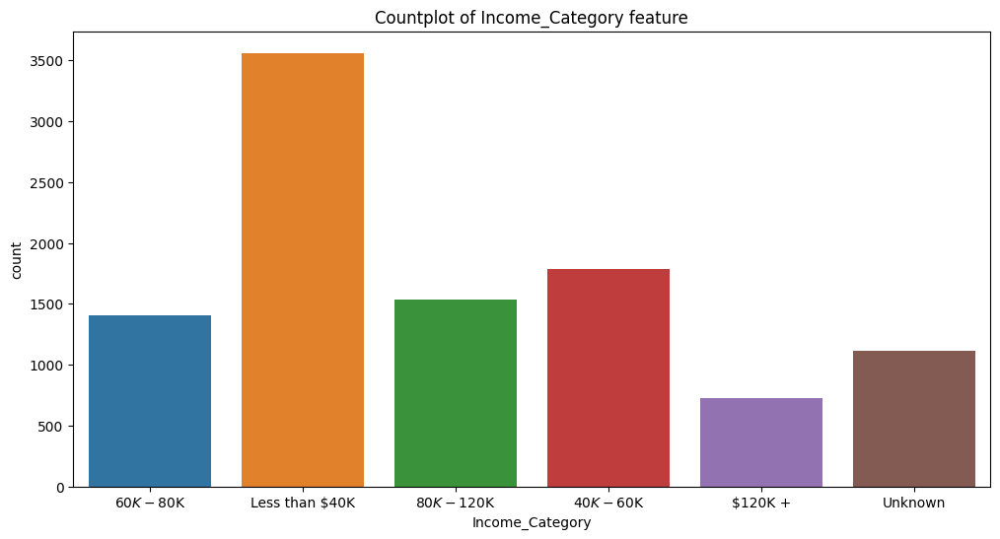

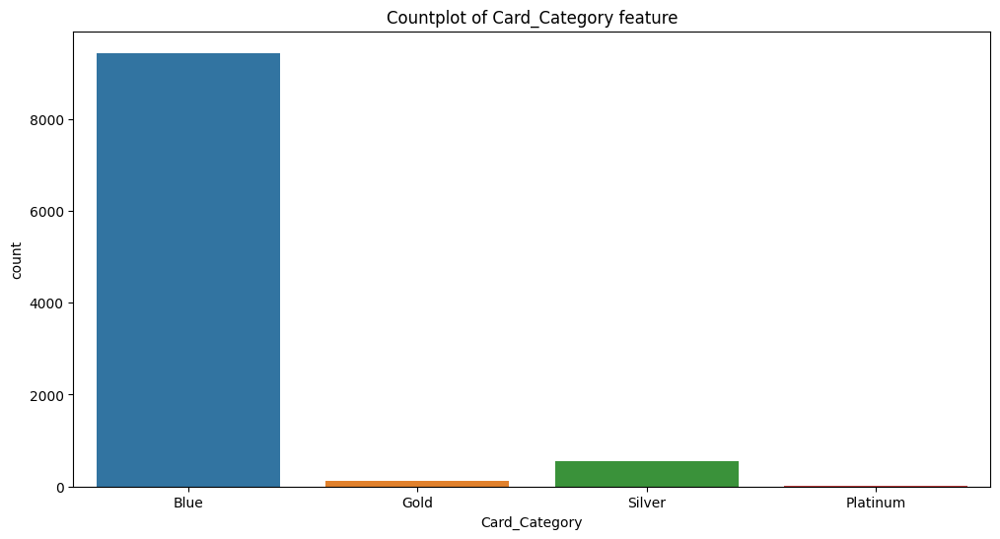

In [12]:
### Analysing the Dataset

for col in credit_churn_dataset.columns:
    if col != 'Attrition_Flag' and credit_churn_dataset.dtypes[col]==object:
        fig, axes = plt.subplots(1,1,figsize = (12,6))
        sns.countplot(data = credit_churn_dataset, x = col)
        plt.title(f"Countplot of {col} feature")

<Axes: xlabel='Dependent_count', ylabel='count'>

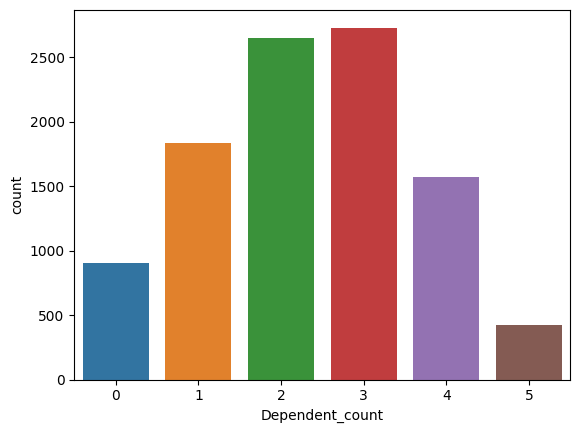

In [13]:
sns.countplot(data = credit_churn_dataset, x = 'Dependent_count')

/var/folders/b6/l1n962ss59n521_0vxpckrcr0000gn/T/ipykernel_35590/2837039523.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(credit_churn_dataset[col])
/var/folders/b6/l1n962ss59n521_0vxpckrcr0000gn/T/ipykernel_35590/2837039523.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(credit_churn_

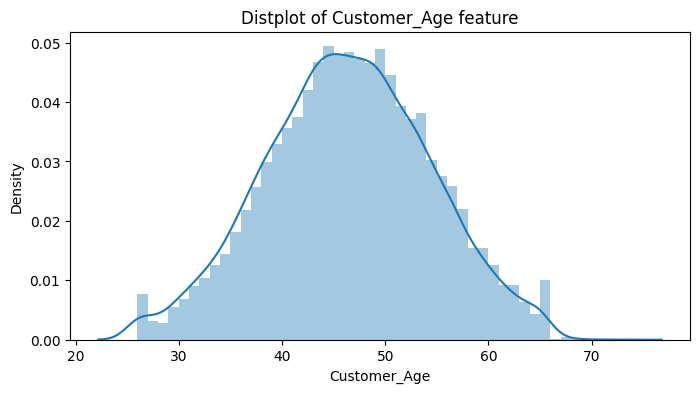

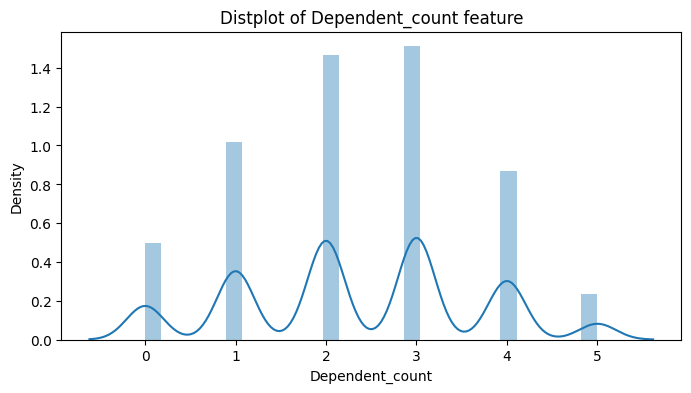

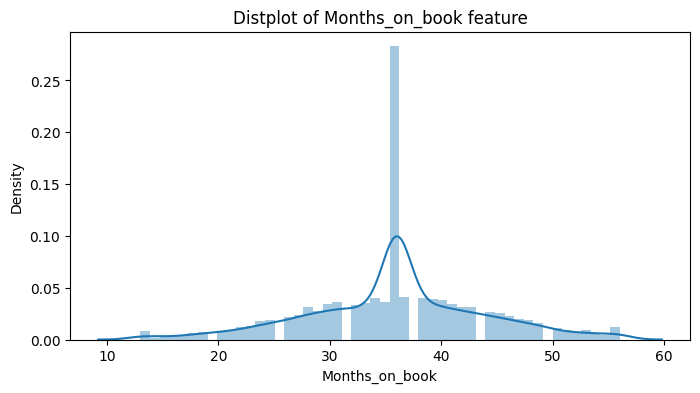

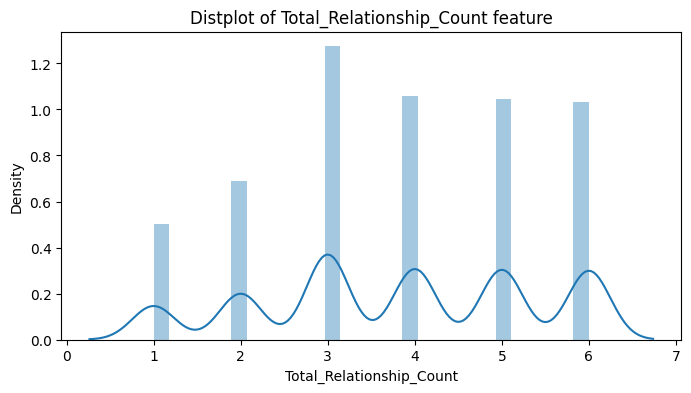

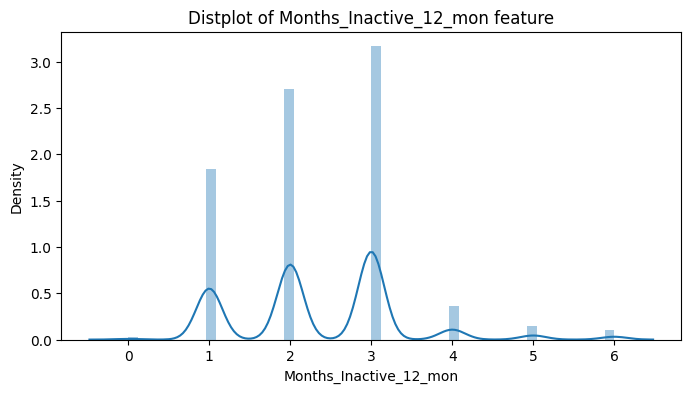

...

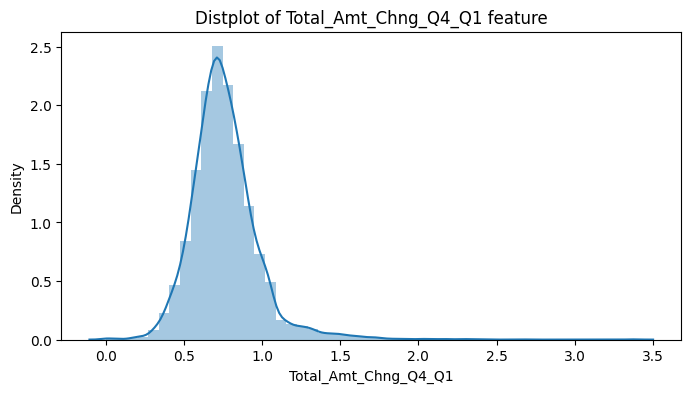

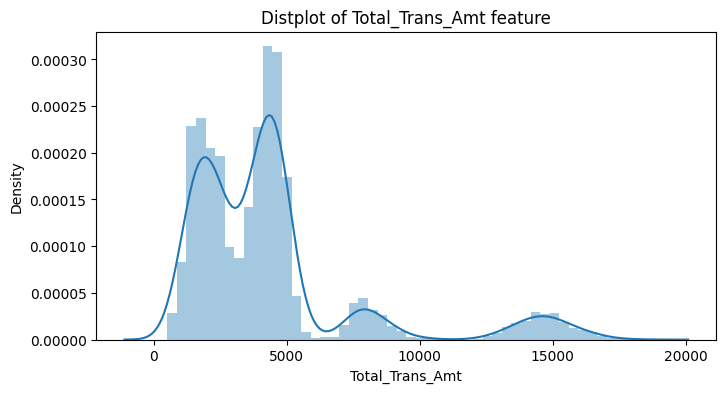

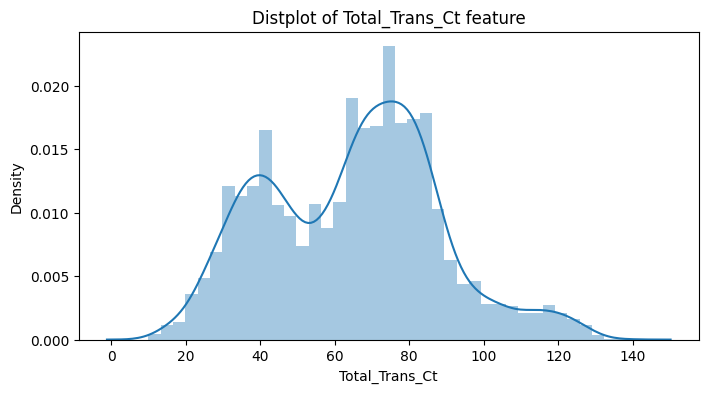

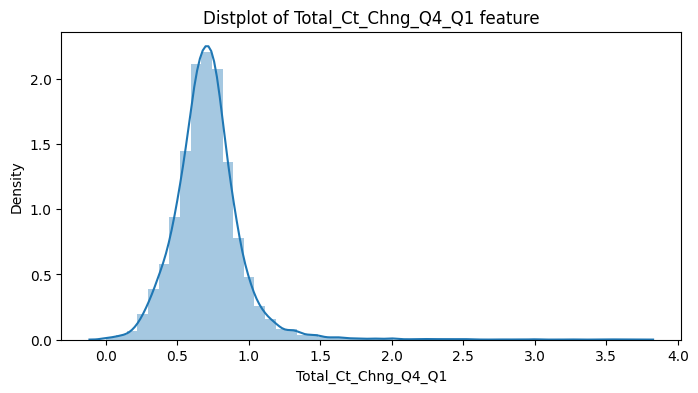

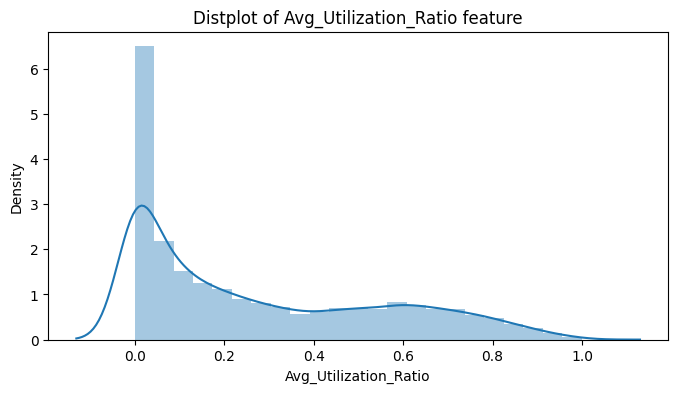

In [14]:
###Distribution of the dataset by numerical features 
for col in credit_churn_dataset.columns:
    if col != 'Attrition_Flag' and col != 'CLIENTNUM' and (credit_churn_dataset.dtypes[col] == int or credit_churn_dataset.dtypes[col] ==float):
        fig, axes = plt.subplots(1,1,figsize = (8,4))
        sns.distplot(credit_churn_dataset[col])
        plt.title(f"Distplot of {col} feature")

In [15]:
##Counting the Users Count by Card Category and by Income Category
credit_churn_dataset.groupby('Income_Category').aggregate({'Card_Category': 'value_counts'})

Card_Category
Income_Category Card_Category               
$120K +         Blue                     645
                Silver                    60
                Gold                      18
                Platinum                   4
$40K - $60K     Blue                    1675
                Silver                    99
                Gold                      15
                Platinum                   1
$60K - $80K     Blue                    1273
                Silver                    96
                Gold                      29
                Platinum                   4
$80K - $120K    Blue                    1395
                Silver                   117
                Gold                      21
                Platinum                   2
Less than $40K  Blue                    3403
                Silver                   130
                Gold                      24
                Platinum                   4
Unknown         Blue                    1045
                Silver                    53
                Gold                       9
                Platinum                   5

<Axes: xlabel='Income_Category', ylabel='count'>

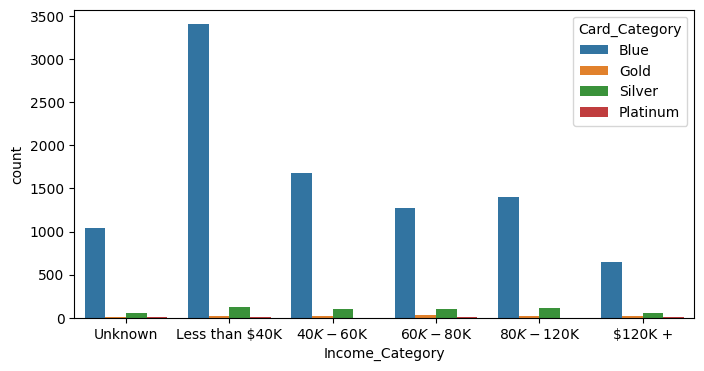

In [16]:
fig,axes = plt.subplots(1,1,figsize=(8,4))
cols = ['Unknown','Less than $40K','$40K - $60K','$60K - $80K','$80K - $120K','$120K +']
sns.countplot(data = credit_churn_dataset, x = 'Income_Category', hue = 'Card_Category', ax = axes, order = cols)

In [17]:
## Among all the income categories, Blue is the most popular Card Category, followed by Silver

<Axes: xlabel='Income_Category', ylabel='Avg_Utilization_Ratio'>

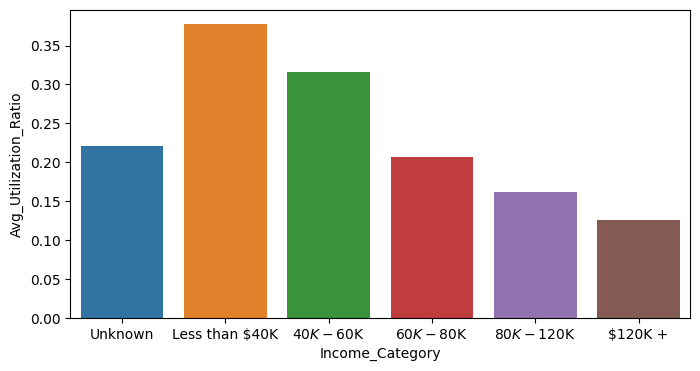

In [18]:
### Credit Utilisation across Income Categories
utilisation = credit_churn_dataset.groupby('Income_Category').aggregate({'Avg_Utilization_Ratio': 'mean'})
cols = ['Unknown','Less than $40K','$40K - $60K','$60K - $80K','$80K - $120K','$120K +']
fig,axes = plt.subplots(1,1,figsize=(8,4))
sns.barplot(data = utilisation,ax = axes, x = utilisation.index, y = utilisation['Avg_Utilization_Ratio'], order = cols)

In [19]:
### As income increases, credit utilization decreases

In [20]:
### Mode Number of relationships by Card Category
mode_of_cards = credit_churn_dataset.groupby('Card_Category').aggregate({'Total_Relationship_Count':pd.Series.mode})
mode_of_cards.columns = ['Relationship count max occured']
mode_of_cards

,Relationship count max occured
Card_Category,
Blue,3
Gold,2
Platinum,2
Silver,2


In [21]:
## Customers with Blue Cards mostly have 3 Product Relationships, Gold have 2 relationships etc.

Text(0.5, 1.0, 'Total revolving balance with income category')

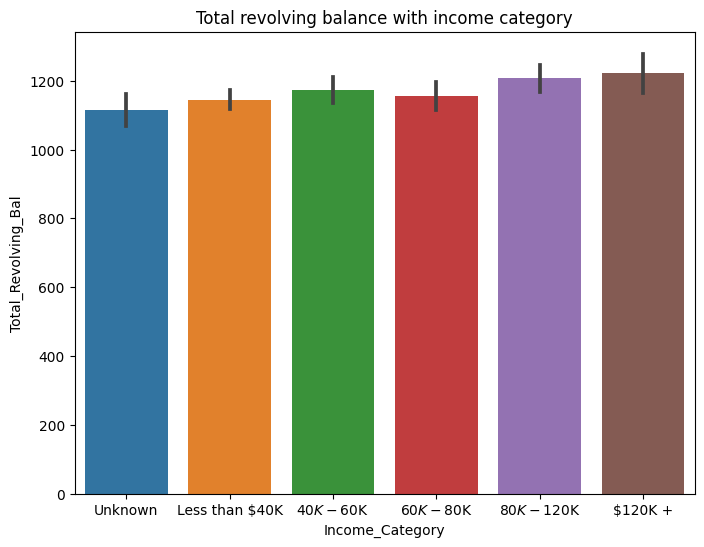

In [22]:
### Total Revolving Balance with Income Category
plt.figure(figsize = (8,6))
sns.barplot(data = credit_churn_dataset, x = 'Income_Category', y = 'Total_Revolving_Bal', order = cols)
plt.title('Total revolving balance with income category')

In [23]:
###Revolving balance is the same or similar across Income Groups

In [24]:
credit_churn_dataset.groupby('Income_Category').aggregate({'Total_Revolving_Bal':pd.Series.mean
                                                                             })

,Total_Revolving_Bal
Income_Category,
$120K +,1222.196699
$40K - $60K,1171.994413
$60K - $80K,1154.993581
$80K - $120K,1206.727036
Less than $40K,1145.136759
Unknown,1115.064748


In [25]:
credit_churn_dataset.set_index('CLIENTNUM', inplace = True)

In [26]:
##Get Categorical Variables
cat_columns = list(credit_churn_dataset.select_dtypes(object).columns)
cat_columns

['Attrition_Flag',
 'Gender',
 'Education_Level',
 'Marital_Status',
 'Income_Category',
 'Card_Category']

In [27]:
##Get Numerical Variables
num_columns = list(credit_churn_dataset.select_dtypes(['int64', 'float64']).columns)
num_columns

['Customer_Age',
 'Dependent_count',
 'Months_on_book',
 'Total_Relationship_Count',
 'Months_Inactive_12_mon',
 'Contacts_Count_12_mon',
 'Credit_Limit',
 'Total_Revolving_Bal',
 'Avg_Open_To_Buy',
 'Total_Amt_Chng_Q4_Q1',
 'Total_Trans_Amt',
 'Total_Trans_Ct',
 'Total_Ct_Chng_Q4_Q1',
 'Avg_Utilization_Ratio']

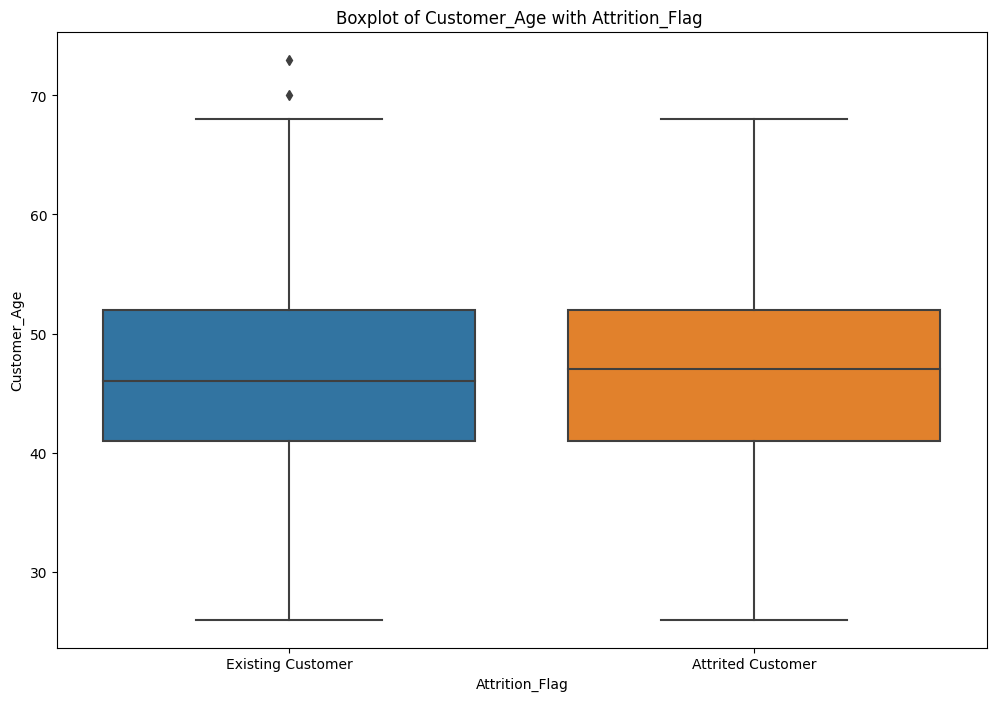

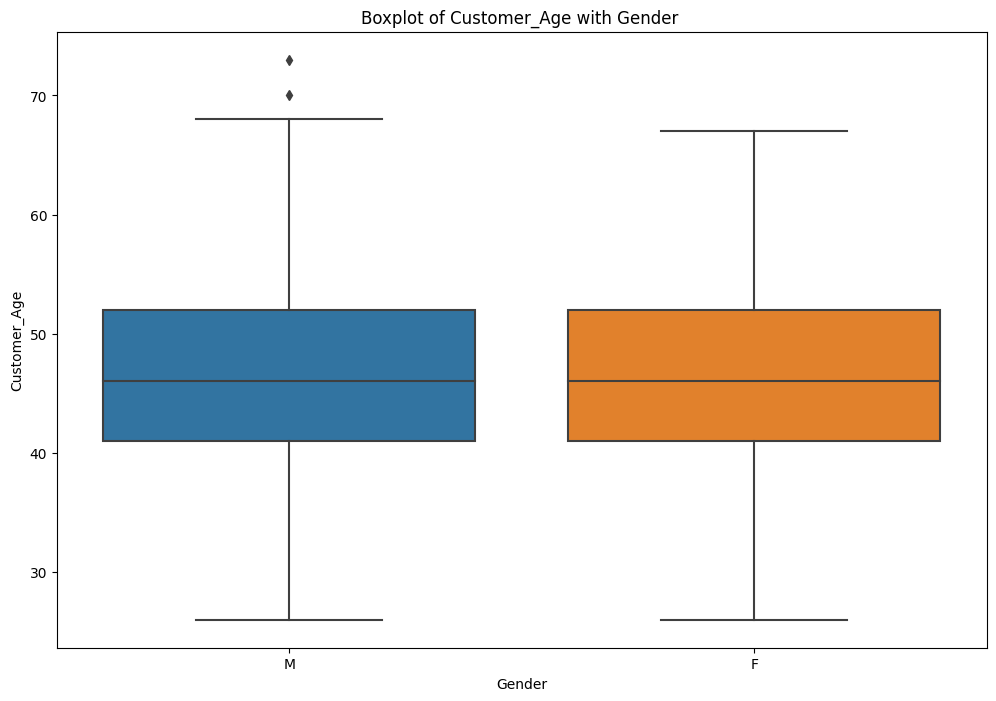

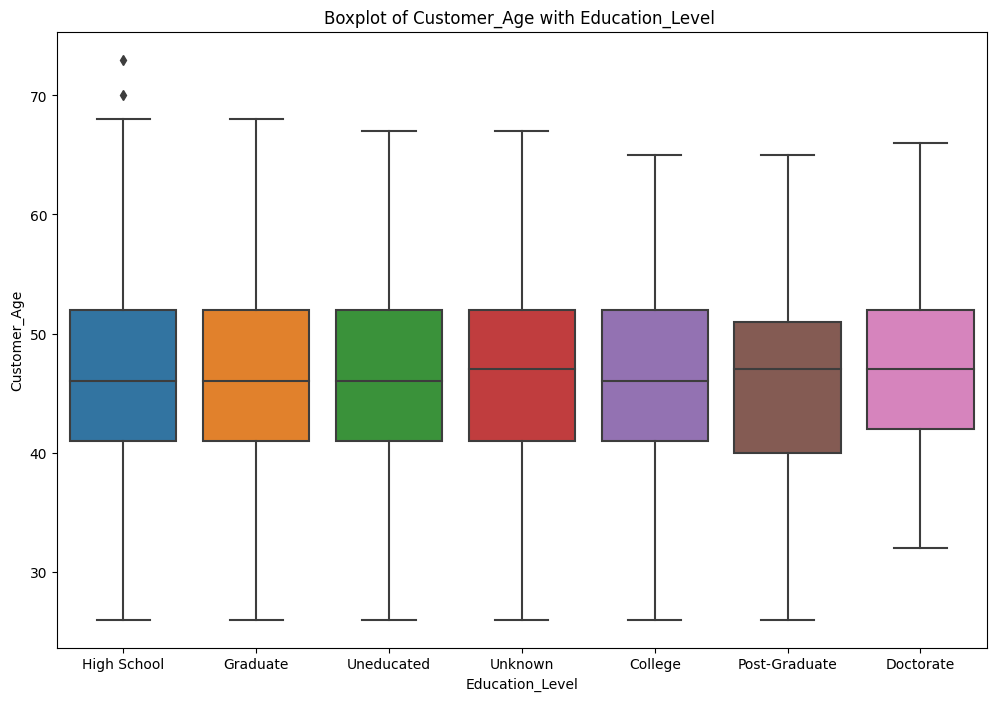

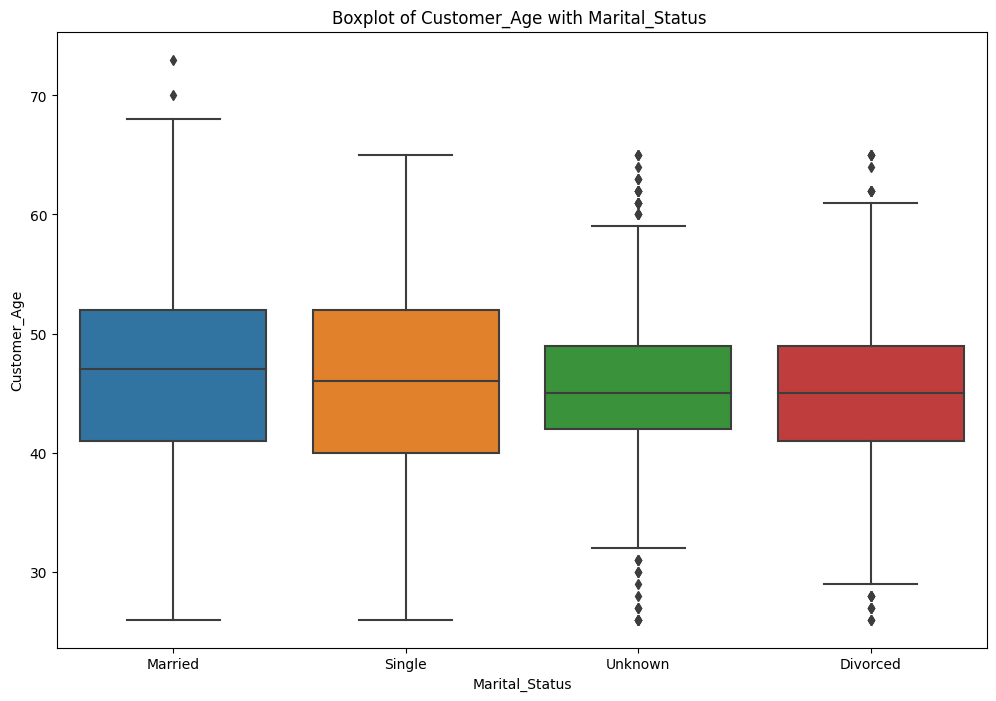

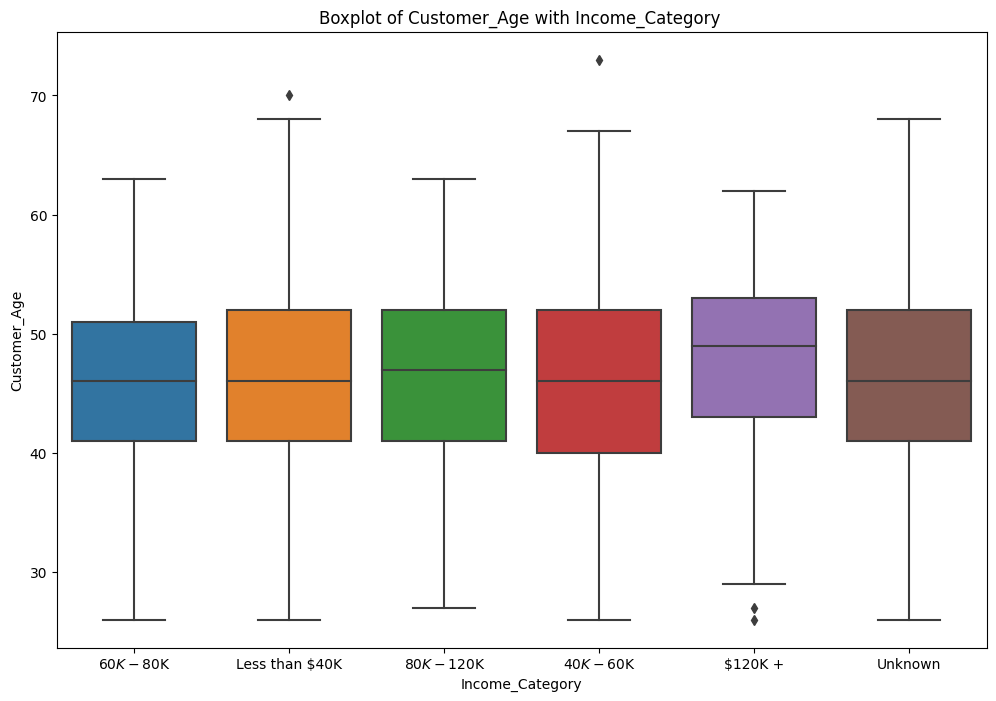

...

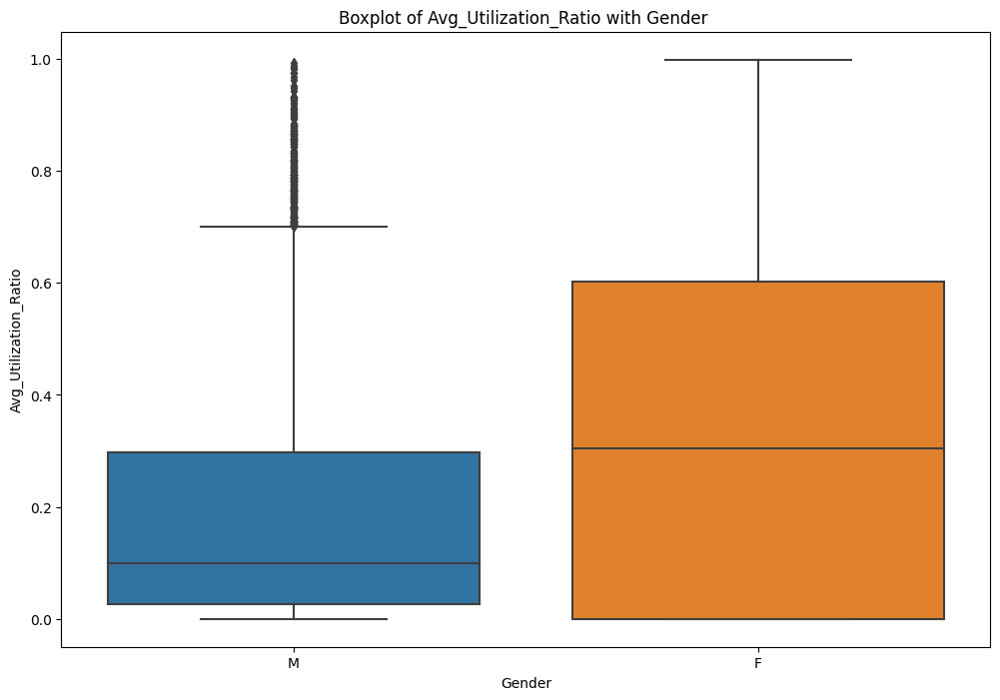

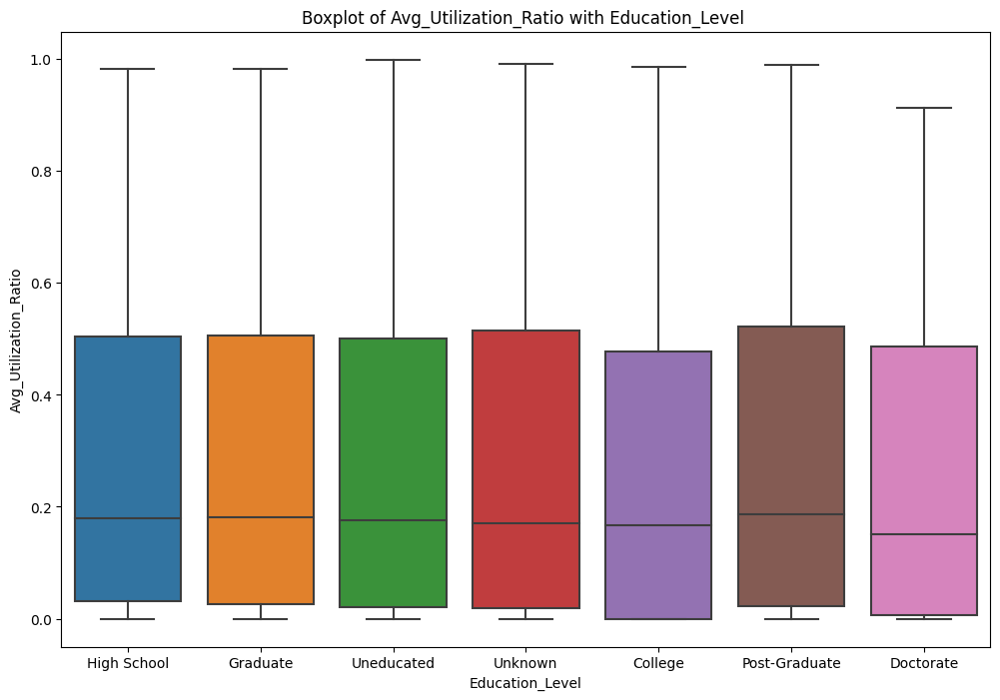

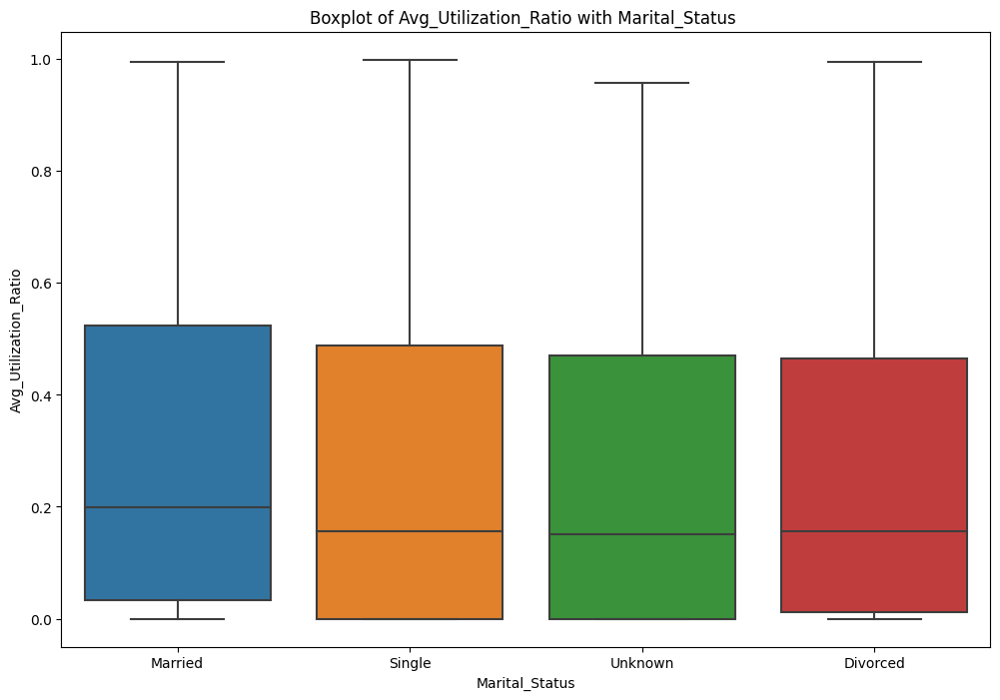

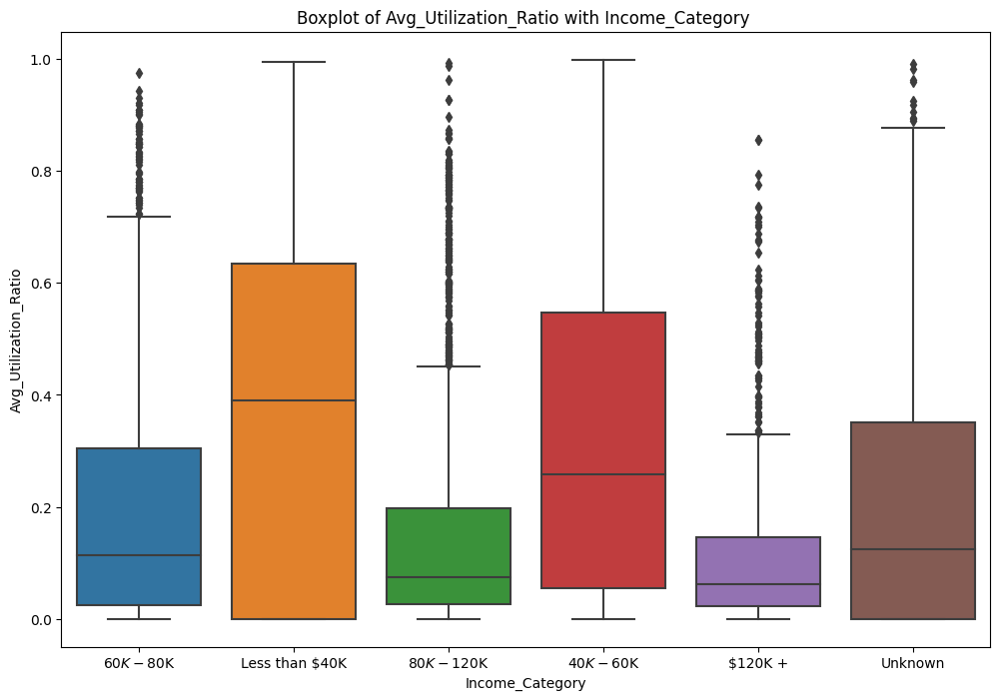

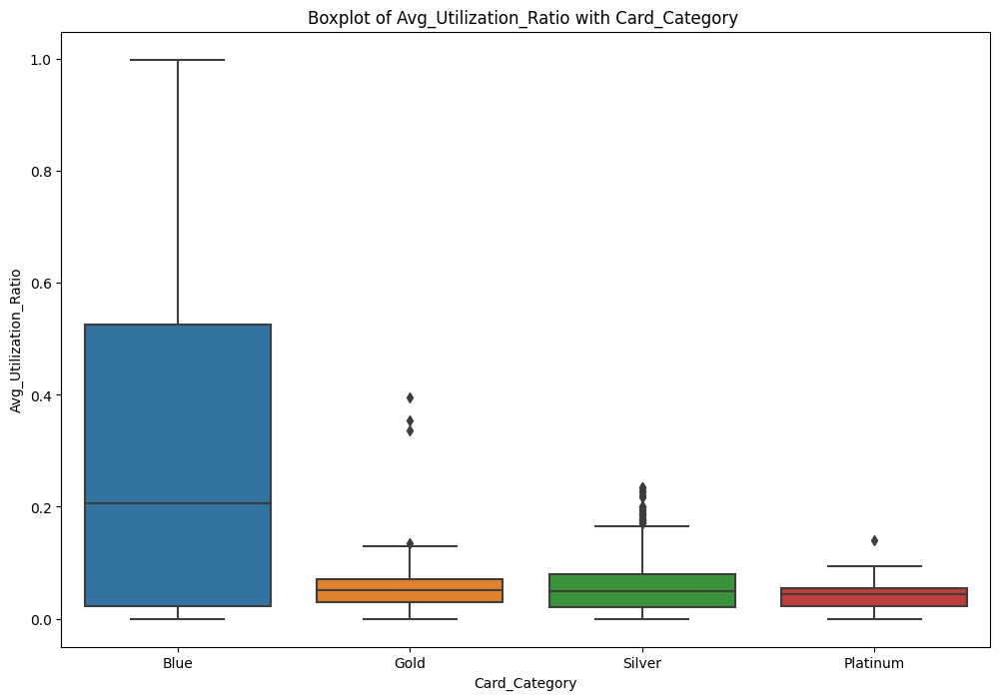

In [28]:
for num in num_columns:
    for col in cat_columns:
        plt.figure(figsize=(12,8))
        sns.boxplot(data = credit_churn_dataset, x = col, y = num)
        plt.title(f'Boxplot of {num} with {col} ')
        plt.show()

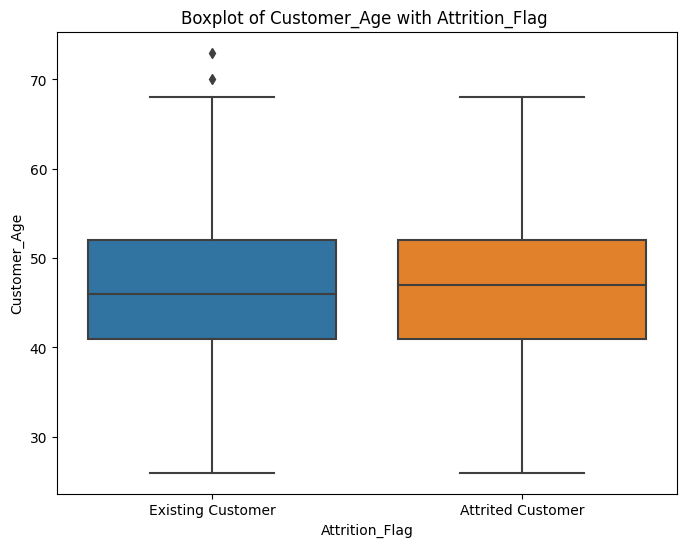

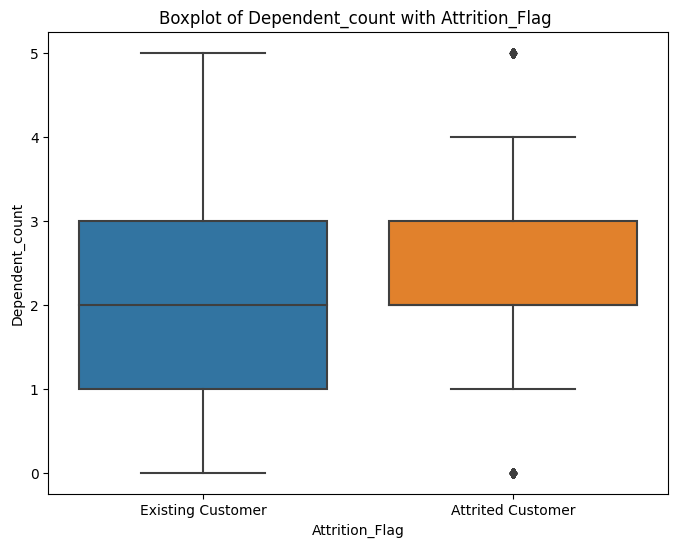

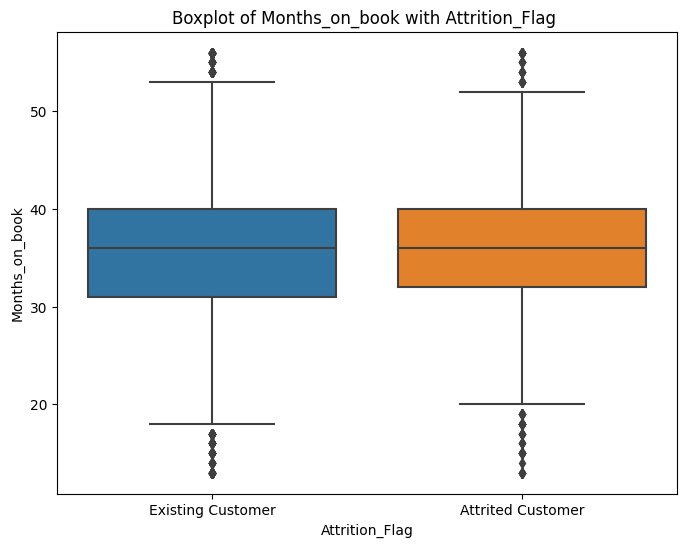

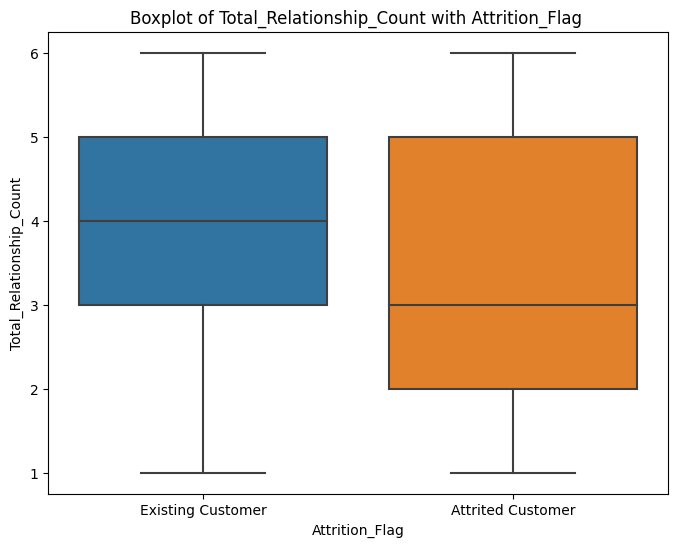

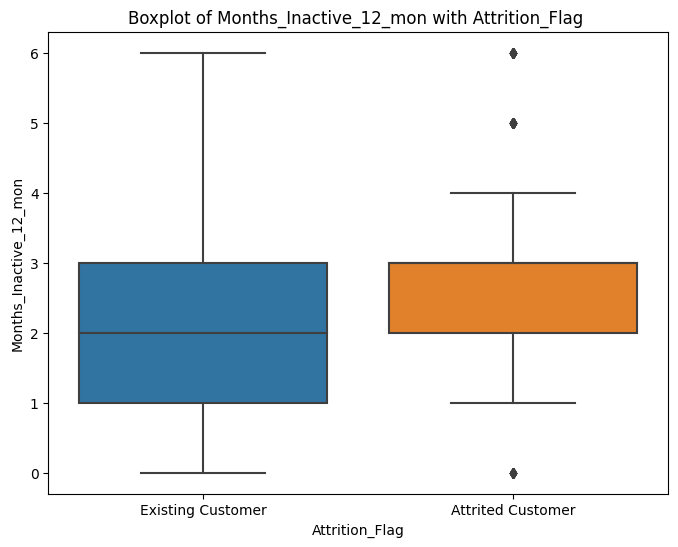

...

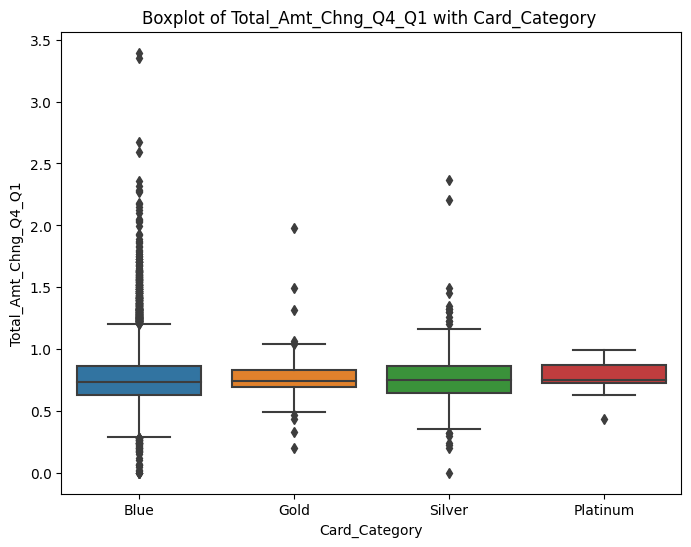

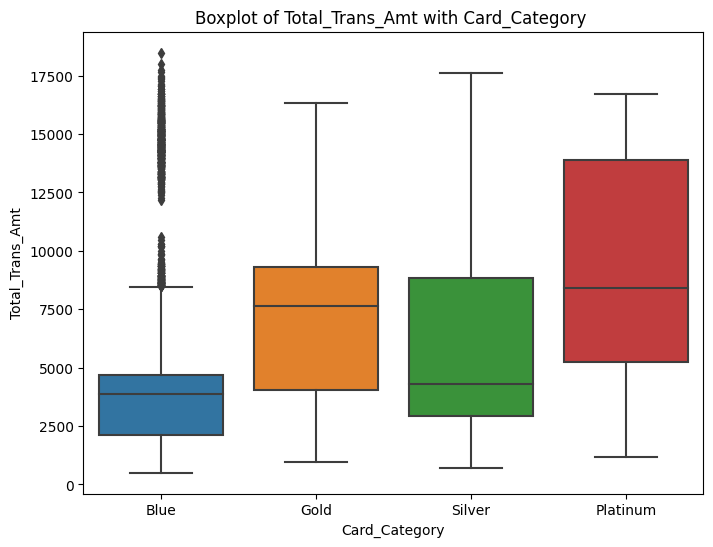

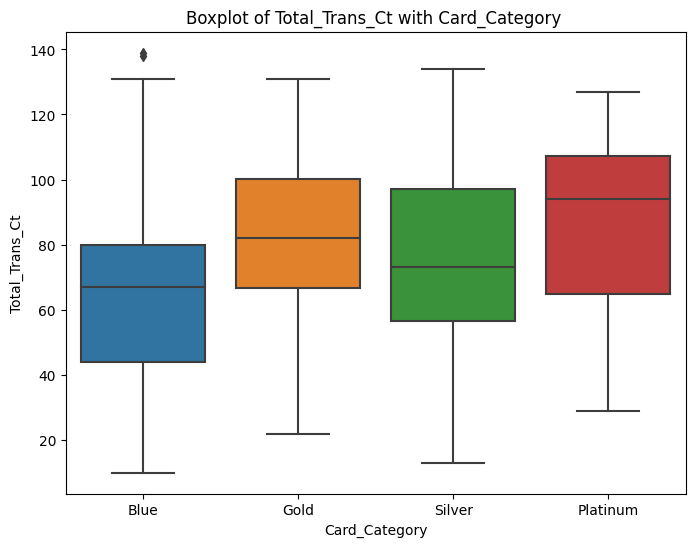

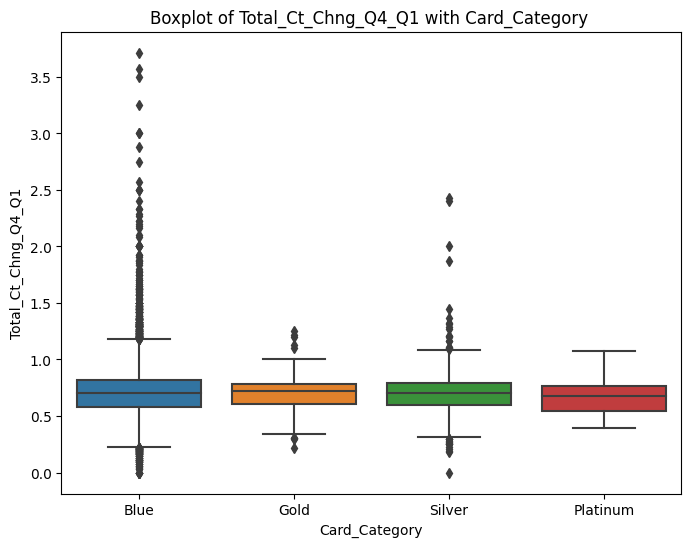

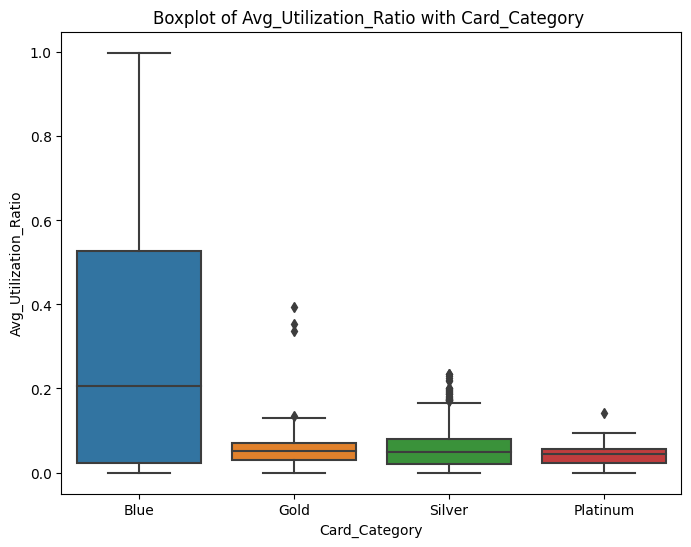

In [29]:
for col in cat_columns:
    for num in num_columns:
        plt.figure(figsize=(8,6))
        sns.boxplot(data = credit_churn_dataset, x = col, y = num)
        plt.title(f'Boxplot of {num} with {col} ')
        plt.show()

In [30]:
#### Observations
##1. Females have a lower credit limit than males
##2. Females have lower Avg open to buy than males
##3. Females have a higher range of avg utlization ratio than males
##4. Married people have the lowest credit limit range
##5. Married people have the highest range of total transaction amount
##6. The customers with the highest income are older than other income groups
##7. Asides from Unknown, credit limit range increases with income

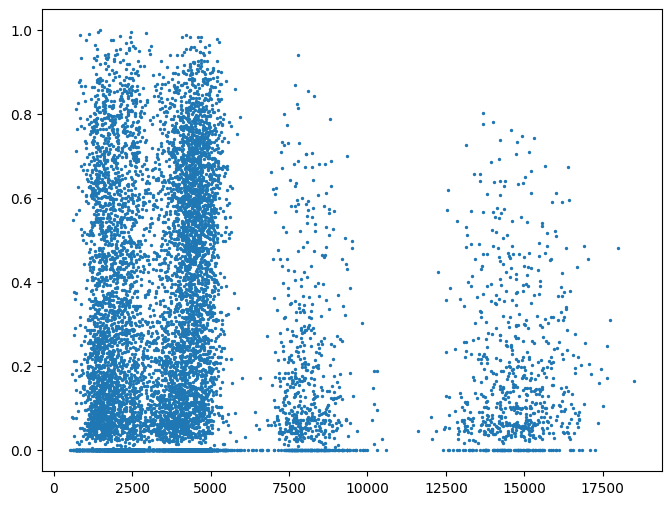

In [31]:
#### plotting a scatter plot on credit utlization ratio and total_trans_amt
plt.figure(figsize = (8,6))
plt.scatter(x = credit_churn_dataset['Total_Trans_Amt'], y = credit_churn_dataset['Avg_Utilization_Ratio'], s = 2 )

/opt/homebrew/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


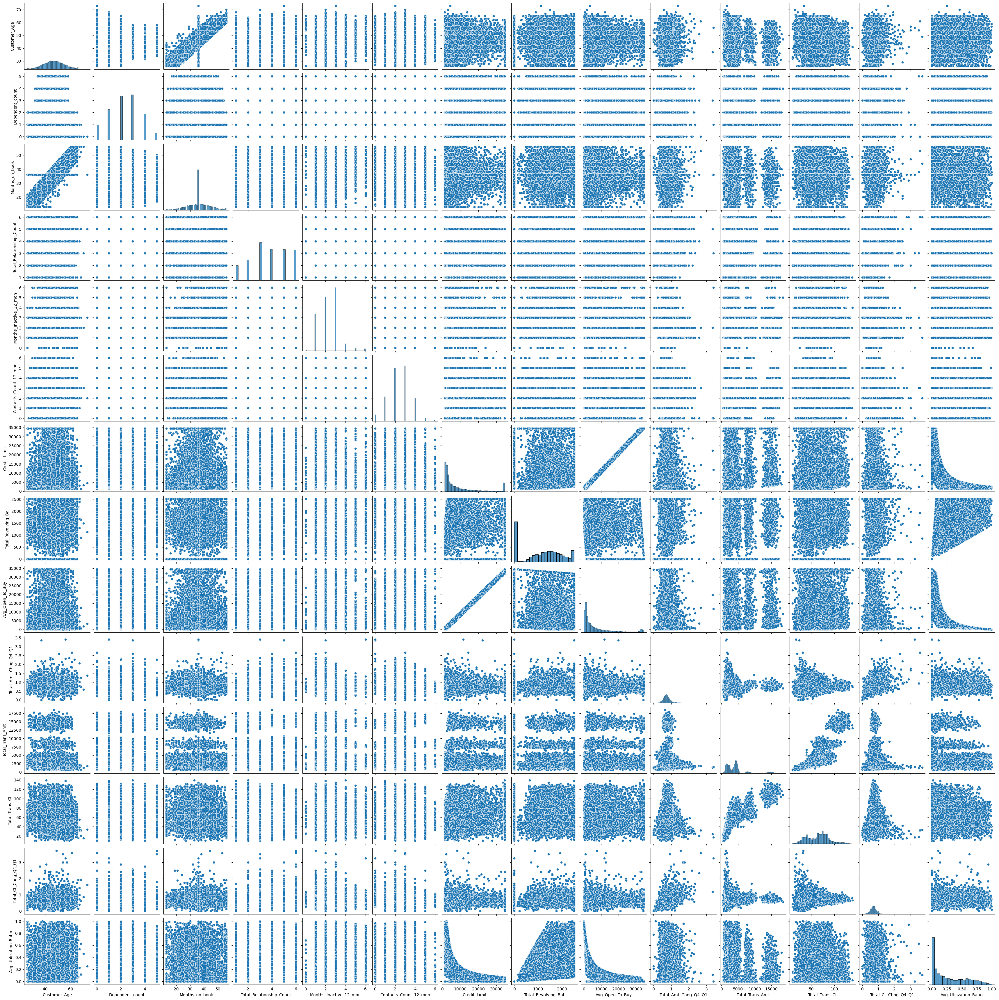

In [32]:
sns.pairplot(data = credit_churn_dataset )

In [33]:
### Notes
##1. Direct relationship between Customer Age and Months on Book
##2. Direct relationship between Credit_Limit and Avg_Open_To_Buy
##3. Inverse relationship between Credit Limit and Avg_Utilization_Ratio
##3. Inverse relationship between Avg_Open_To_Buy and Avg_Utilization_Ratio
##4. Total transaciton Amt is directly proportional to Total_Transaction_Cnt
##5. Direct relationship between Total_Amt_Change_Q4_Q1 and Total_Cnt_Change_Q4_Q1

Text(0.5, 1.0, 'Heatmap for the numerical features in the credit_churn_dataset')

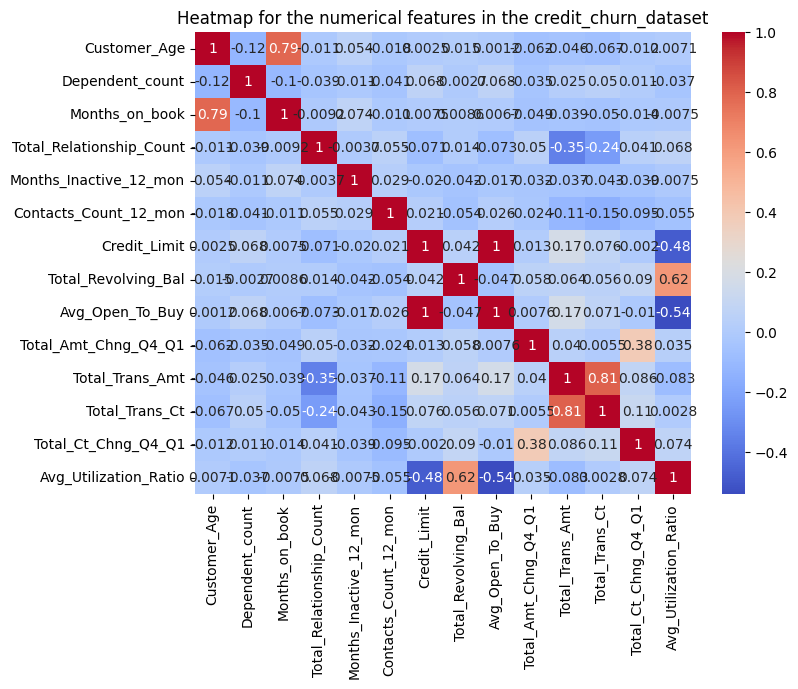

In [34]:
## Drawing A Correlation Matrix
plt.figure(figsize = (8,6))
sns.heatmap(data = credit_churn_dataset[num_columns].corr(), annot = True, cmap = 'coolwarm' )
plt.title('Heatmap for the numerical features in the credit_churn_dataset')

/var/folders/b6/l1n962ss59n521_0vxpckrcr0000gn/T/ipykernel_35590/143375208.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,axes = plt.subplots(1,2, figsize = (12,6))


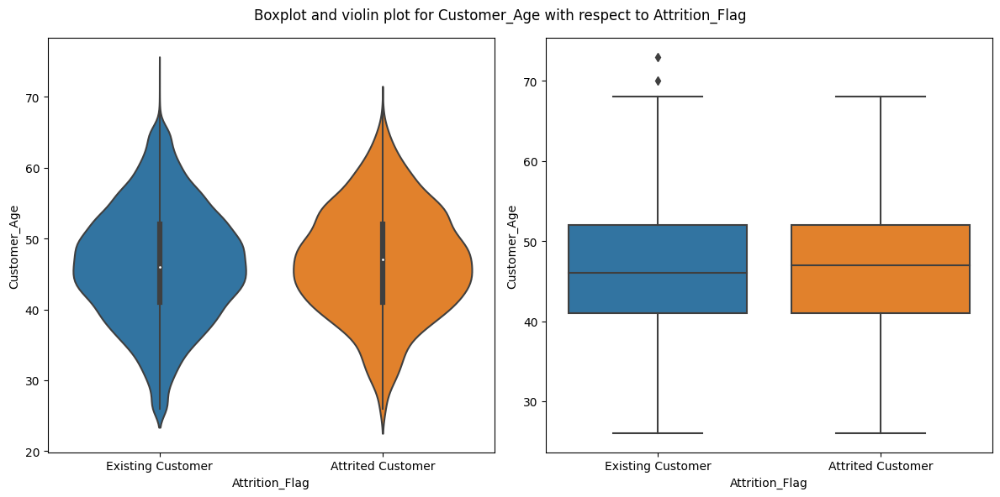

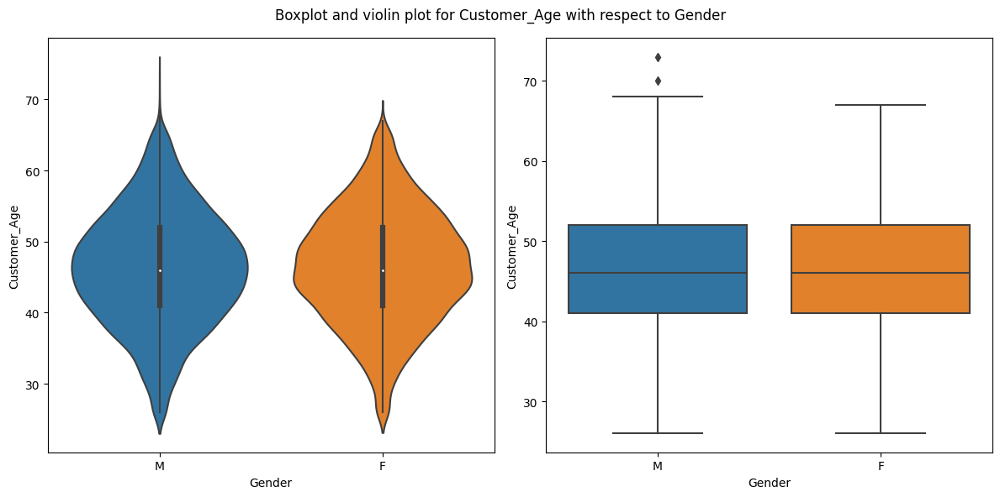

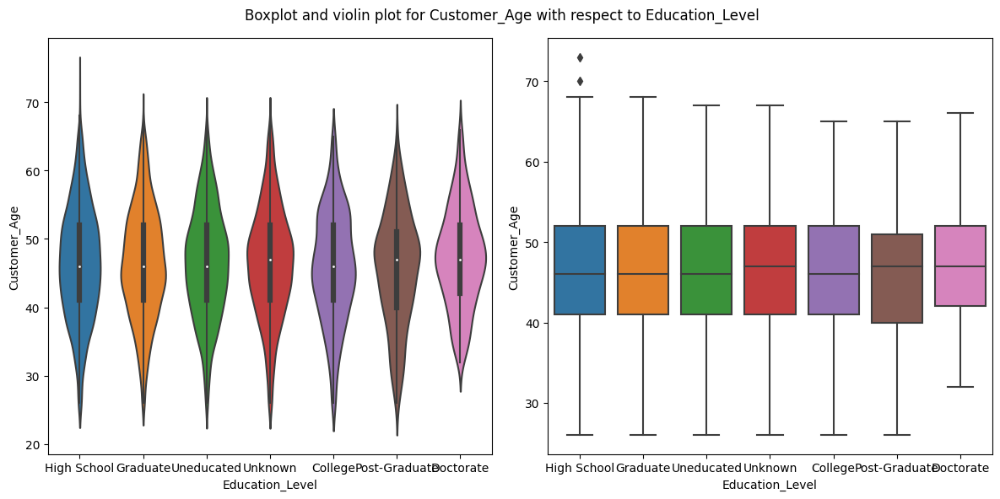

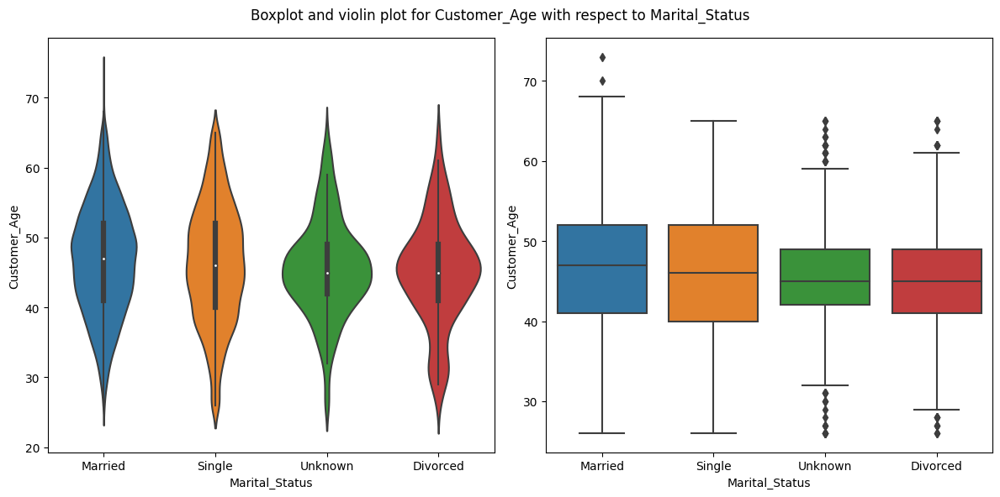

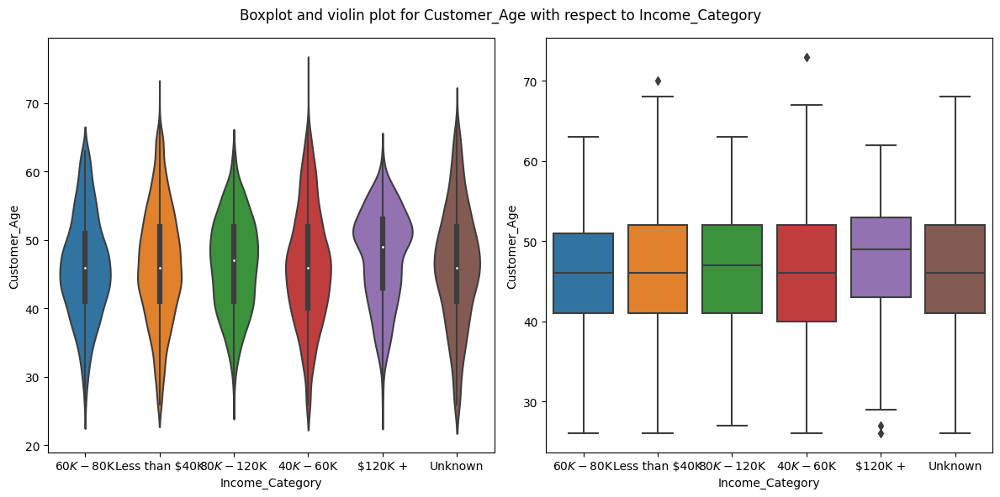

...

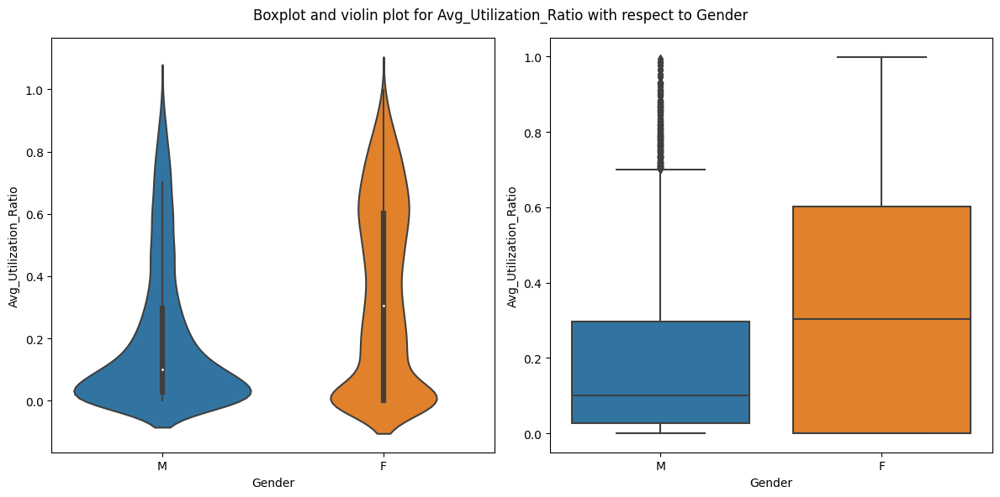

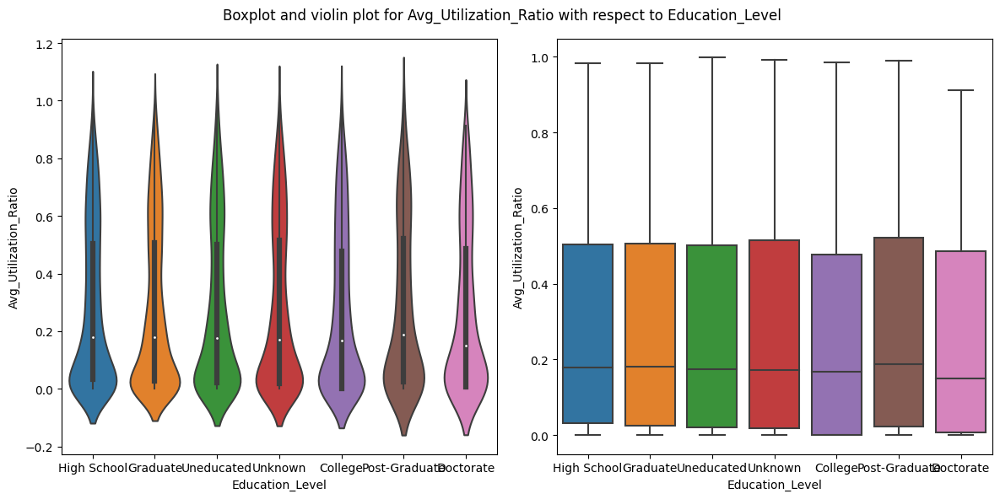

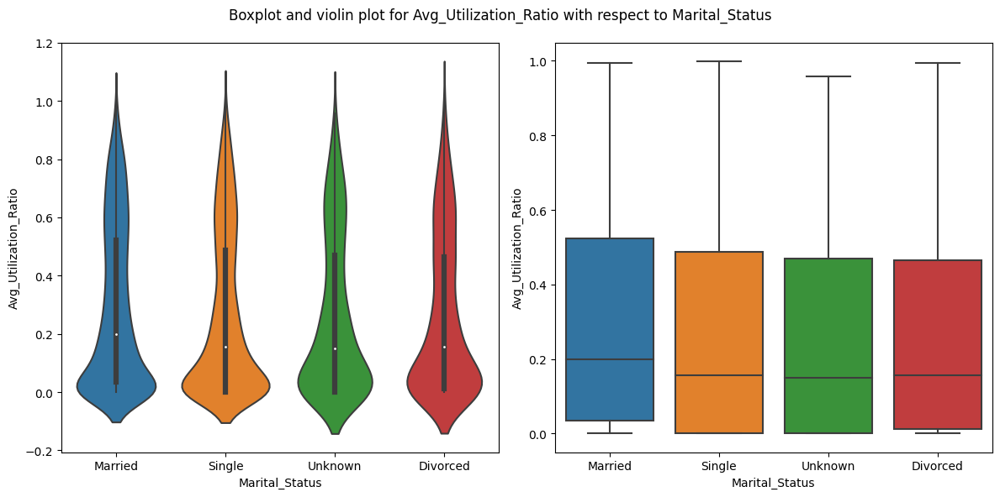

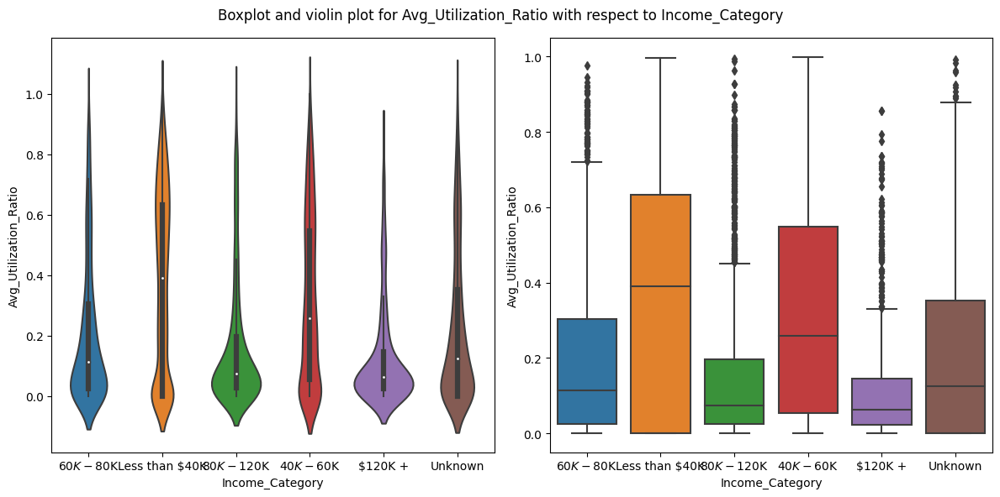

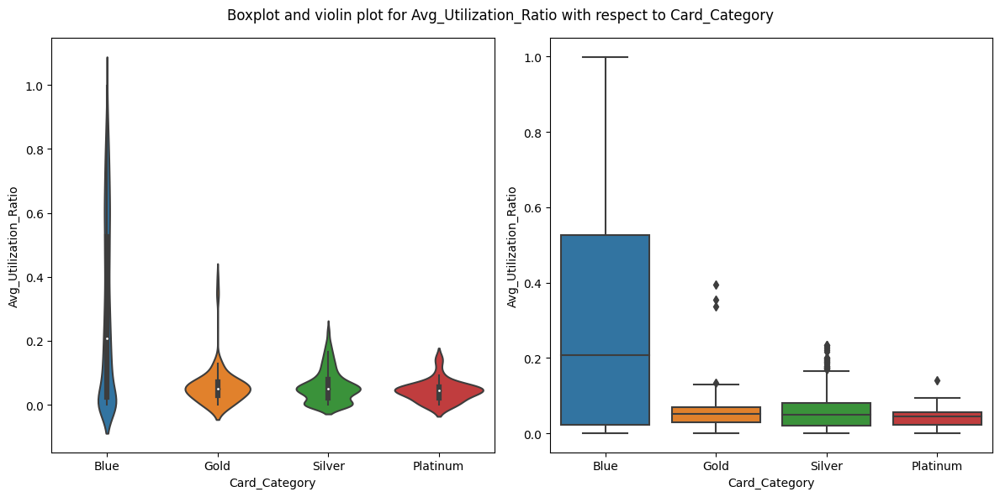

In [35]:
for num in num_columns:
    for col in cat_columns:
        fig,axes = plt.subplots(1,2, figsize = (12,6))
        sns.violinplot(data = credit_churn_dataset, x = col, y = num, ax= axes[0])
        sns.boxplot(data = credit_churn_dataset, x = col, y = num, ax= axes[1])
        plt.suptitle(f'Boxplot and violin plot for {num} with respect to {col}')
        plt.tight_layout()
        

<Axes: xlabel='Customer_Age', ylabel='Probability'>

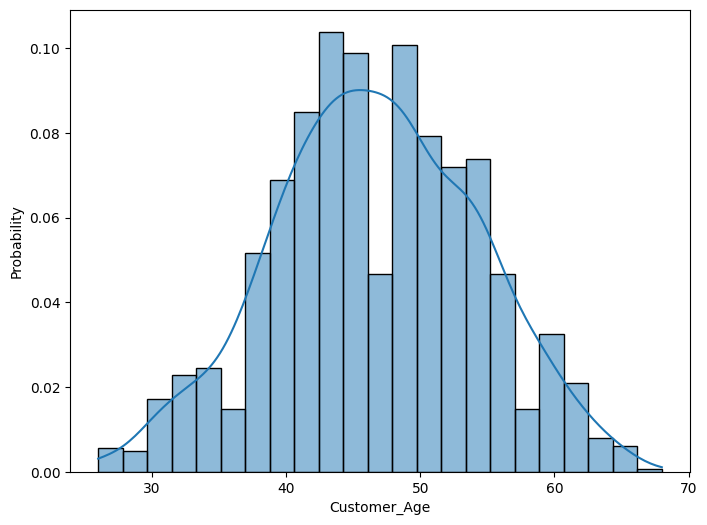

In [36]:
###Analysing the Attrited Customers, we examine the distribution across age, gender, marital status, income category etc.
attrited_customers = credit_churn_dataset[credit_churn_dataset["Attrition_Flag"] == "Attrited Customer"]
plt.figure(figsize = (8,6))
sns.histplot(data = attrited_customers['Customer_Age'], kde = True, stat='probability')

<Axes: xlabel='Gender', ylabel='count'>

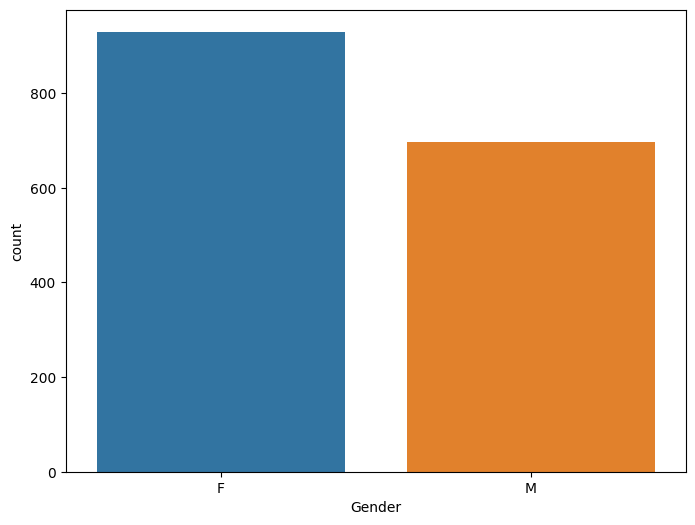

In [37]:
plt.figure(figsize = (8,6))
sns.countplot(data = attrited_customers, x='Gender')

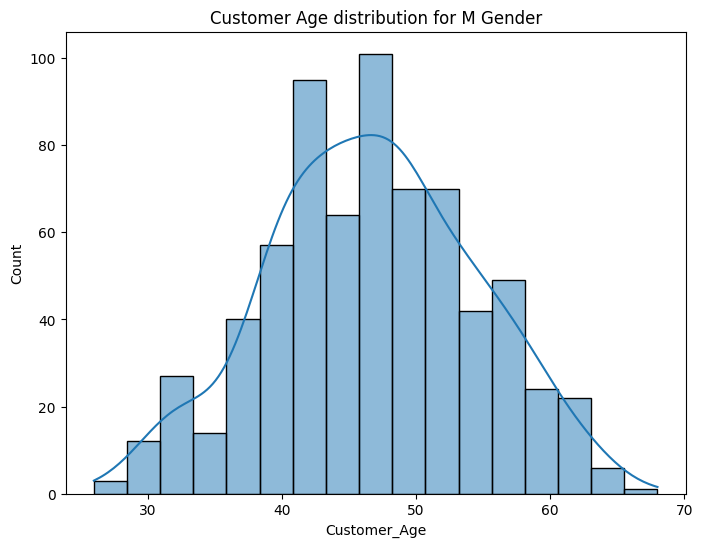

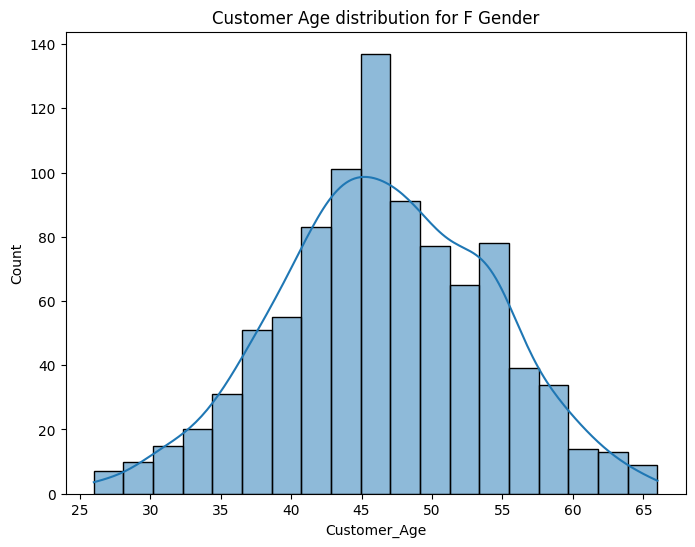

In [38]:
for  i in ['M', 'F']:
    temp = attrited_customers[attrited_customers['Gender']==i]
    plt.figure(figsize = (8,6))
    sns.histplot(temp['Customer_Age'], kde = True)
    plt.title(f'Customer Age distribution for {i} Gender')
    plt.show()

<Axes: xlabel='Marital_Status', ylabel='count'>

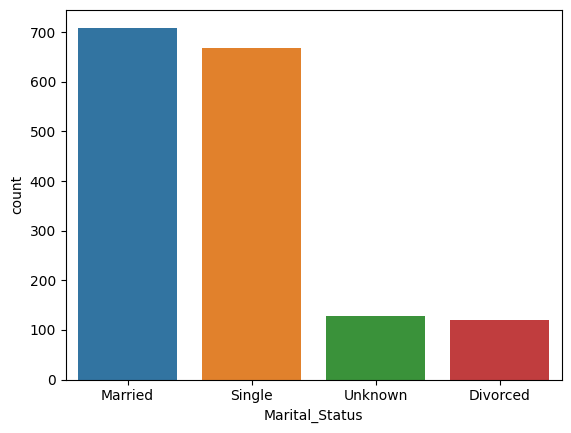

In [39]:
sns.countplot(data = attrited_customers, x = 'Marital_Status')

<Axes: xlabel='Income_Category', ylabel='count'>

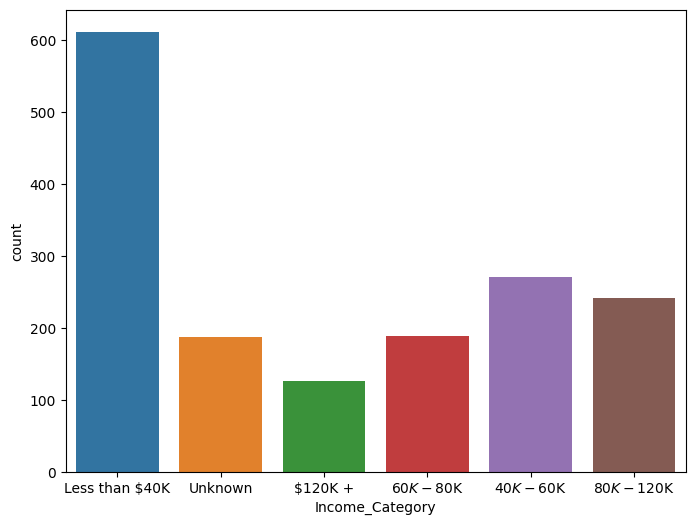

In [40]:
plt.figure(figsize = (8,6))
sns.countplot(data = attrited_customers, x = 'Income_Category')

<Axes: xlabel='Income_Category', ylabel='Total_Revolving_Bal'>

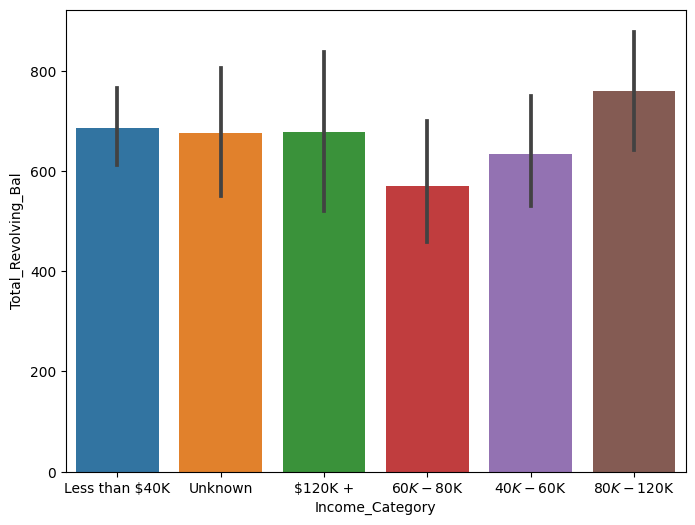

In [41]:
plt.figure(figsize = (8,6))
sns.barplot(data = attrited_customers, x = 'Income_Category', y = 'Total_Revolving_Bal')

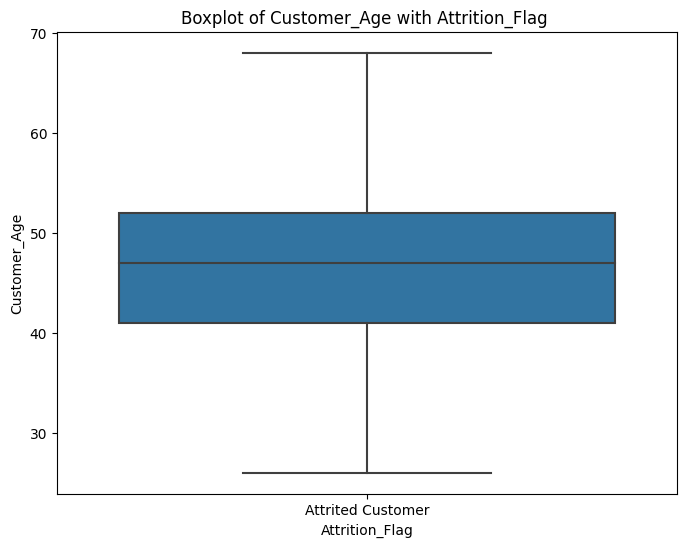

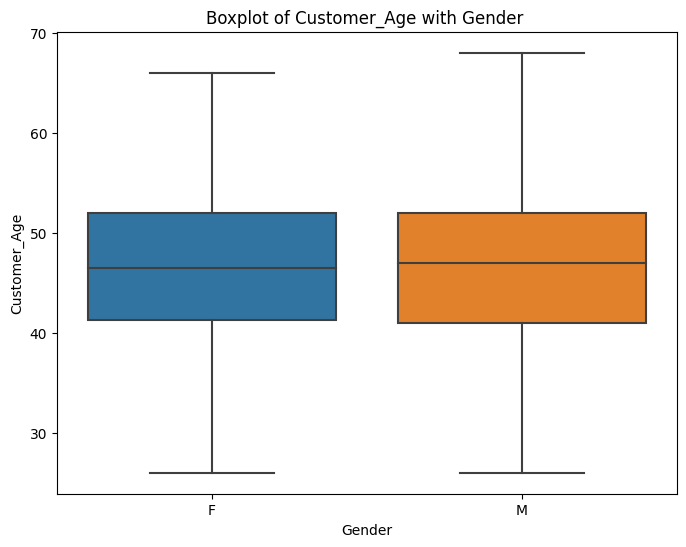

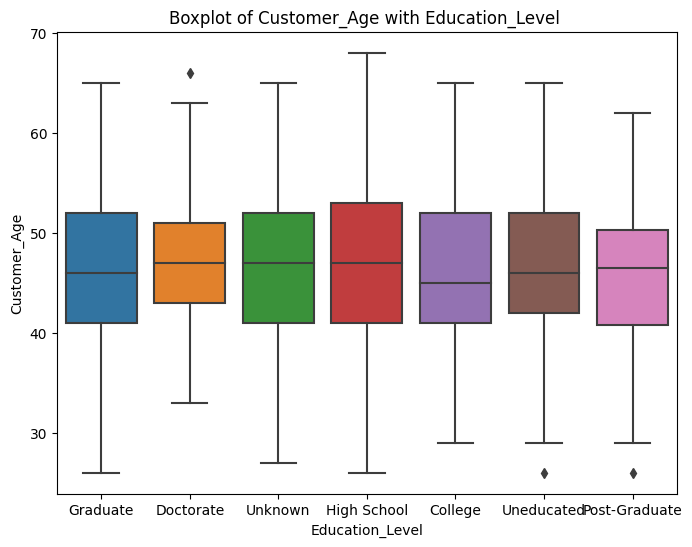

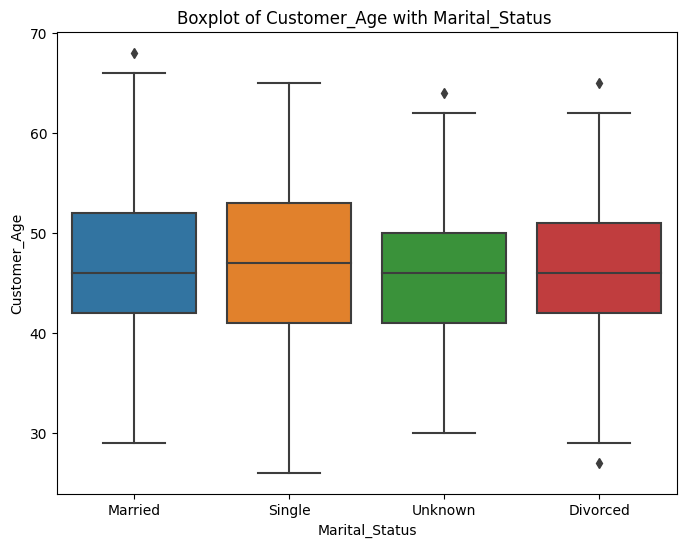

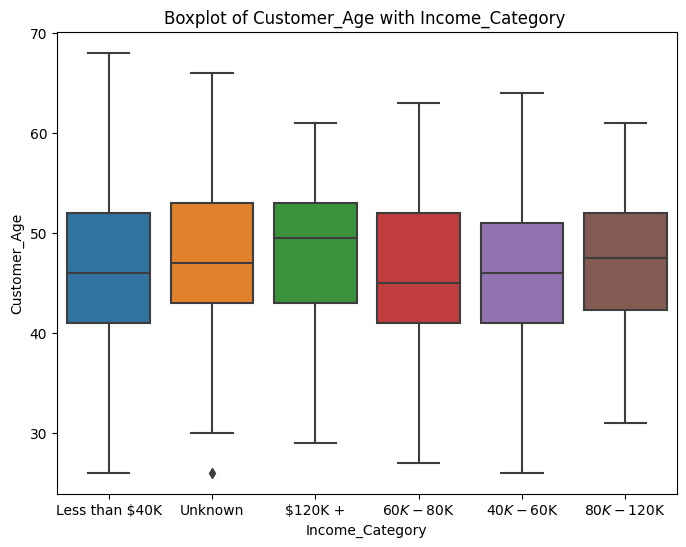

...

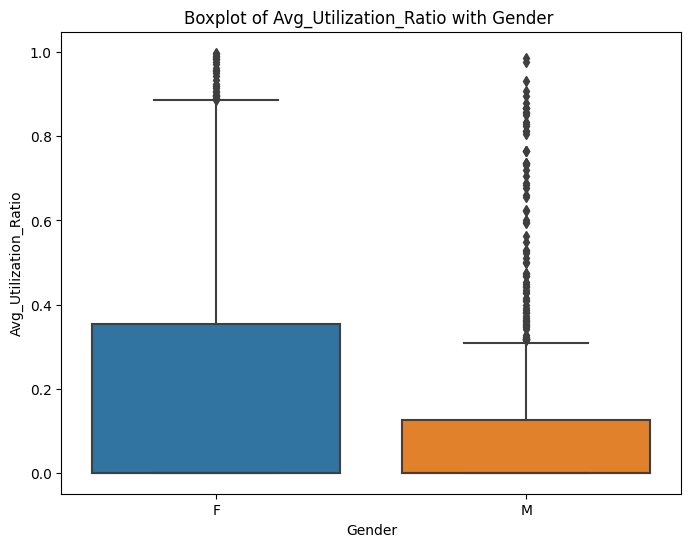

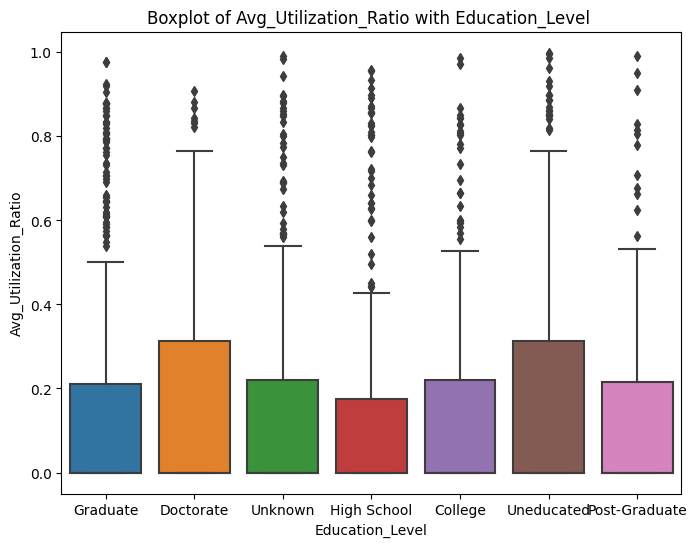

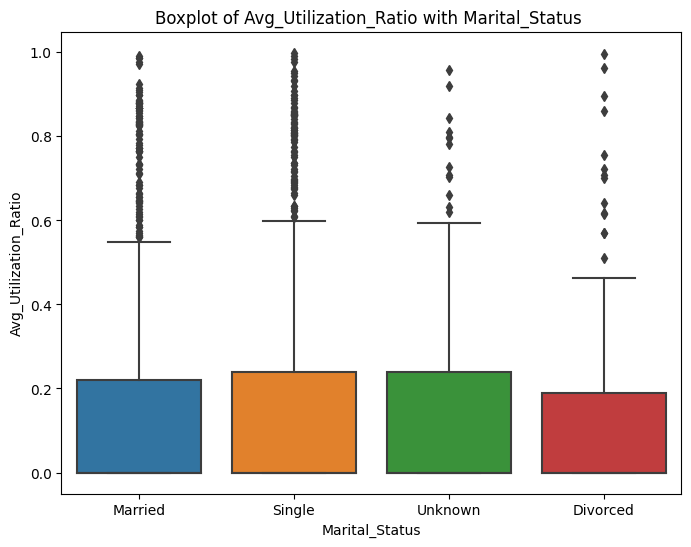

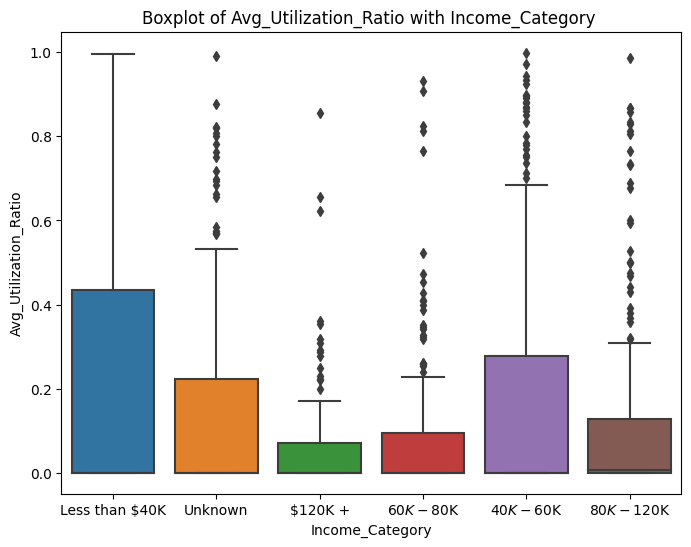

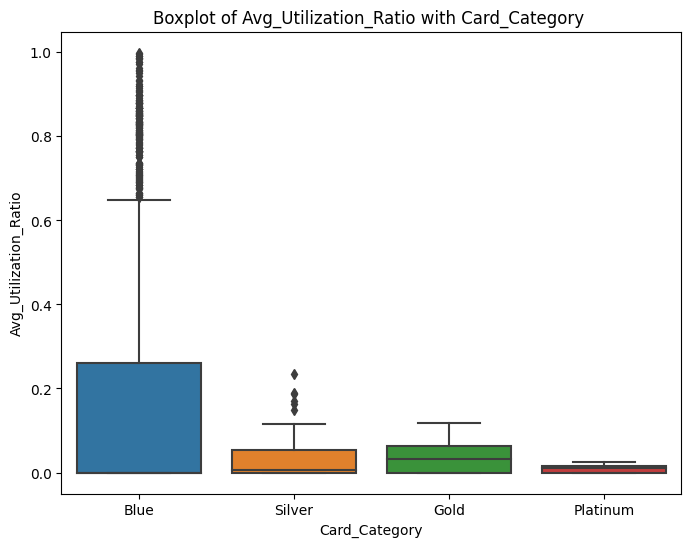

In [42]:
for num in num_columns:
    for col in cat_columns:
        plt.figure(figsize=(8,6))
        sns.boxplot(data = attrited_customers, x = col, y = num)
        plt.title(f'Boxplot of {num} with {col} ')
        plt.show()

/var/folders/b6/l1n962ss59n521_0vxpckrcr0000gn/T/ipykernel_35590/3561310118.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(attrited_customers[col])
/var/folders/b6/l1n962ss59n521_0vxpckrcr0000gn/T/ipykernel_35590/3561310118.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(attrited_custom

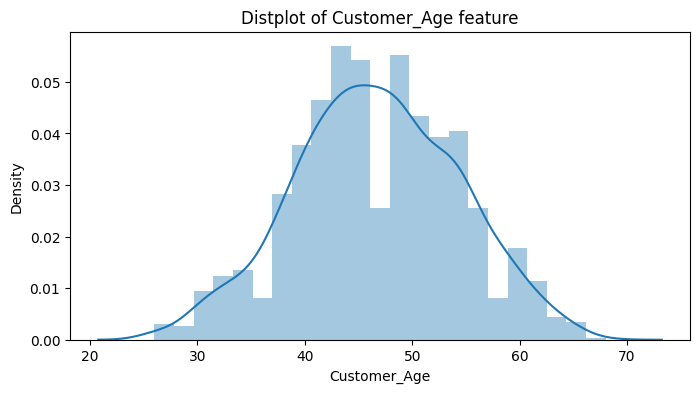

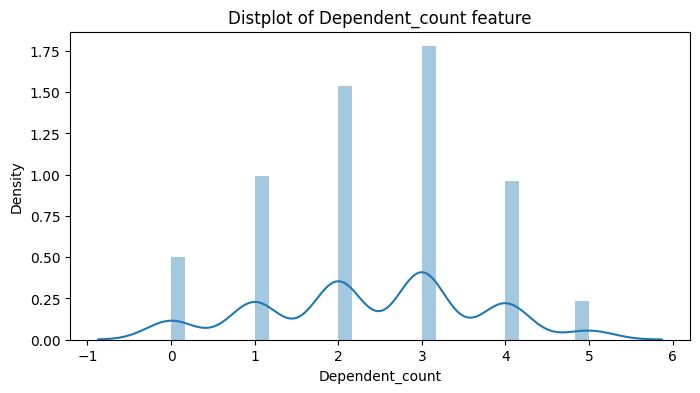

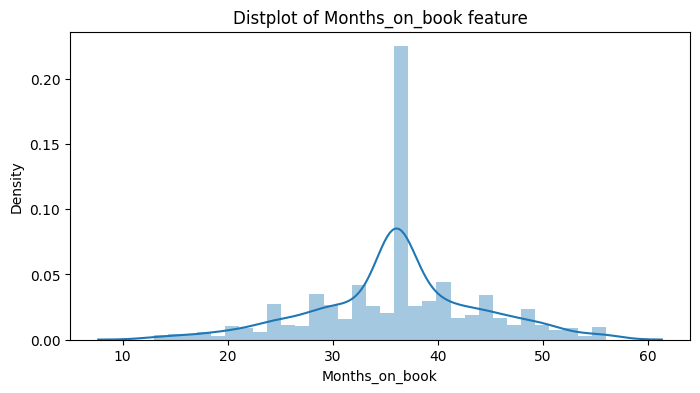

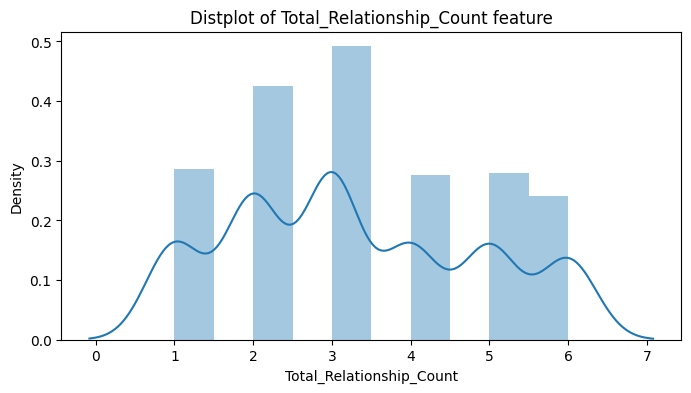

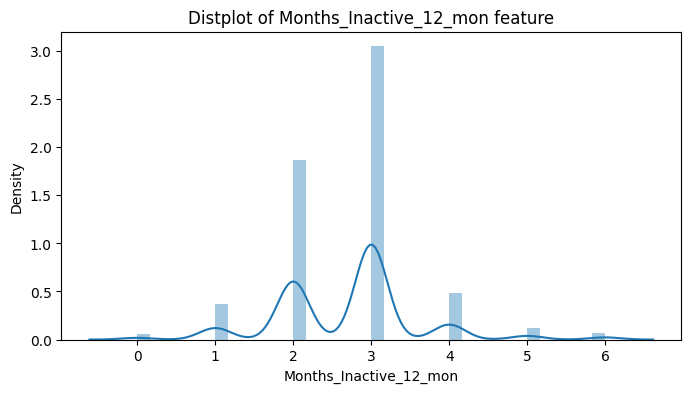

...

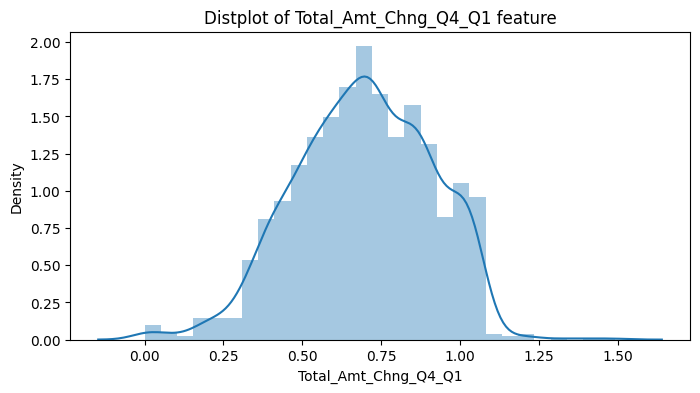

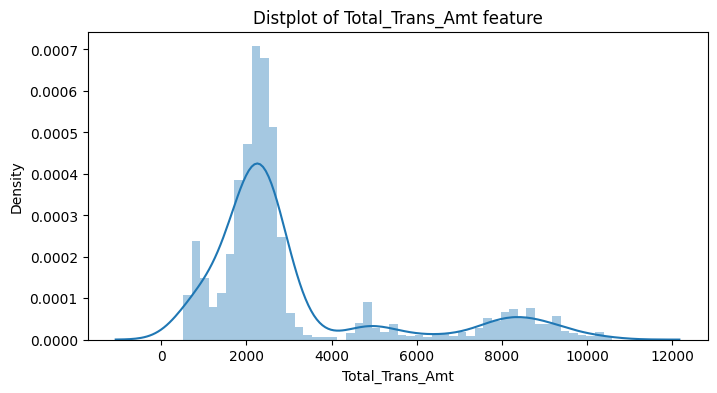

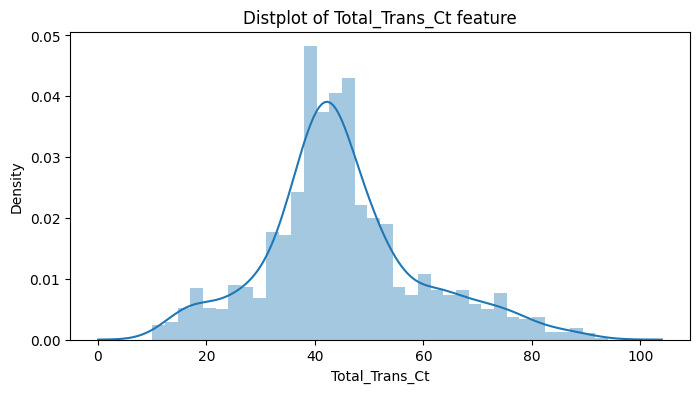

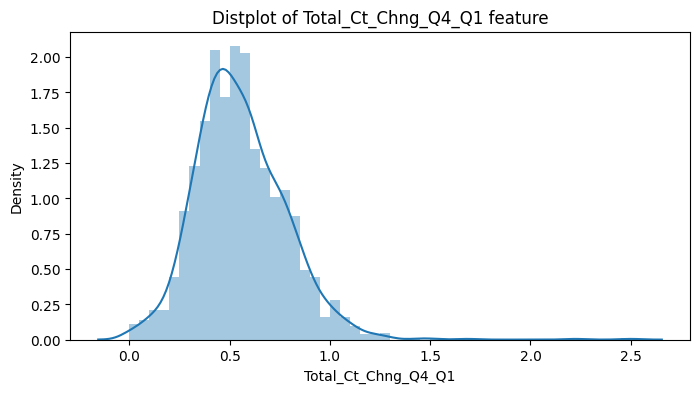

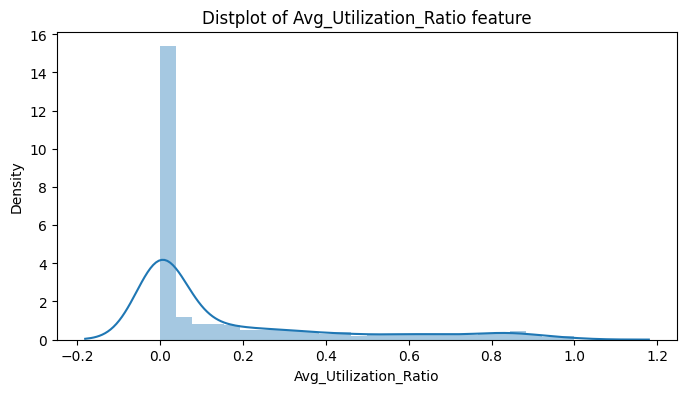

In [43]:
for col in attrited_customers.columns:
    if col != 'Attrition_Flag' and col != 'CLIENTNUM' and (attrited_customers.dtypes[col] == int or attrited_customers.dtypes[col] ==float):
        fig, axes = plt.subplots(1,1,figsize = (8,4))
        sns.distplot(attrited_customers[col])
        plt.title(f"Distplot of {col} feature")
        

In [44]:
#### Machine Learning and Predictions Preprocessing
### First, we try to classify using Logistic Regression and K-Nearest Neighbour

###For the categorical columns, we need to run get_dummies to replace with the logical equivalent
dummies_col = []
for col in credit_churn_dataset.columns:
    distinccount = credit_churn_dataset[col].nunique()
    if distinccount <= 7 and credit_churn_dataset.dtypes[col]==object and col != 'Attrition_Flag':
        print('Unique count of '+ col + ' is ' + str(distinccount))
        dummies_col.append(col)

Unique count of Gender is 2
Unique count of Education_Level is 7
Unique count of Marital_Status is 4
Unique count of Income_Category is 6
Unique count of Card_Category is 4


In [45]:
dummies_col

['Gender',
 'Education_Level',
 'Marital_Status',
 'Income_Category',
 'Card_Category']

In [46]:
##Append dummies to a duplicate of the dataset. We will use the duplicate going forward
##drop_first will remove the first count element in each category appended
credit_churn_dataset_dup = credit_churn_dataset.copy()
for i in dummies_col:
    temp_dummy = pd.get_dummies(credit_churn_dataset_dup[i], drop_first = True, prefix = i)
    temp_dummy.replace({True:1,False: 0}, inplace = True)
    credit_churn_dataset_dup = pd.concat([credit_churn_dataset_dup, temp_dummy], axis = 1)
    credit_churn_dataset_dup.drop(i, axis = 1, inplace = True)

In [47]:
credit_churn_dataset_dup

,Attrition_Flag,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,...,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver
CLIENTNUM,,,,,,,,,,,,,,,,,,,,,
768805383,Existing Customer,45,3,39,5,1,3,12691.0,777,11914.0,...,0,0,0,1,0,0,0,0,0,0
818770008,Existing Customer,49,5,44,6,1,2,8256.0,864,7392.0,...,1,0,0,0,0,1,0,0,0,0
713982108,Existing Customer,51,3,36,4,1,0,3418.0,0,3418.0,...,0,0,0,0,1,0,0,0,0,0
769911858,Existing Customer,40,4,34,3,4,1,3313.0,2517,796.0,...,0,1,0,0,0,1,0,0,0,0
709106358,Existing Customer,40,3,21,5,1,0,4716.0,0,4716.0,...,0,0,0,1,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
772366833,Existing Customer,50,2,40,3,2,3,4003.0,1851,2152.0,...,1,0,1,0,0,0,0,0,0,0
710638233,Attrited Customer,41,2,25,4,2,3,4277.0,2186,2091.0,...,0,0,1,0,0,0,0,0,0,0
716506083,Attrited Customer,44,1,36,5,3,4,5409.0,0,5409.0,...,0,0,0,0,0,1,0,0,0,0


In [48]:
###Define X and y variables
X = credit_churn_dataset_dup.drop('Attrition_Flag', axis = 1)
y = credit_churn_dataset_dup['Attrition_Flag']

In [49]:
X.head()

,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,...,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver
CLIENTNUM,,,,,,,,,,,,,,,,,,,,,
768805383,45,3,39,5,1,3,12691.0,777,11914.0,1.335,...,0,0,0,1,0,0,0,0,0,0
818770008,49,5,44,6,1,2,8256.0,864,7392.0,1.541,...,1,0,0,0,0,1,0,0,0,0
713982108,51,3,36,4,1,0,3418.0,0,3418.0,2.594,...,0,0,0,0,1,0,0,0,0,0
769911858,40,4,34,3,4,1,3313.0,2517,796.0,1.405,...,0,1,0,0,0,1,0,0,0,0
709106358,40,3,21,5,1,0,4716.0,0,4716.0,2.175,...,0,0,0,1,0,0,0,0,0,0


In [50]:
X.describe()

,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,...,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver
count,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,...,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000
mean,46.325960,2.346203,35.928409,3.812580,2.341167,2.455317,8631.953698,1162.814061,7469.139637,0.759941,...,0.389355,0.073961,0.176755,0.138442,0.151575,0.351634,0.109805,0.011455,0.001975,0.054804
std,8.016814,1.298908,7.986416,1.554408,1.010622,1.106225,9088.776650,814.987335,9090.685324,0.219207,...,0.487628,0.261720,0.381480,0.345380,0.358626,0.477504,0.312663,0.106416,0.044398,0.227608
min,26.000000,0.000000,13.000000,1.000000,0.000000,0.000000,1438.300000,0.000000,3.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,41.000000,1.000000,31.000000,3.000000,2.000000,2.000000,2555.000000,359.000000,1324.500000,0.631000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,46.000000,2.000000,36.000000,4.000000,2.000000,2.000000,4549.000000,1276.000000,3474.000000,0.736000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,52.000000,3.000000,40.000000,5.000000,3.000000,3.000000,11067.500000,1784.000000,9859.000000,0.859000,...,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
max,73.000000,5.000000,56.000000,6.000000,6.000000,6.000000,34516.000000,2517.000000,34516.000000,3.397000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [51]:
###We need to rescale the numerical columns using StandardScaler
from sklearn.preprocessing import StandardScaler
X_2 = X.copy()
scaler = StandardScaler()
X_2[num_columns] = scaler.fit_transform(X_2[num_columns])

In [52]:
###having rescaled, we will test the columns for multicolinearity using variance inflation factor
### (For details on VIF, see https://www.investopedia.com/terms/v/variance-inflation-factor.asp)
### First import the vif module
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [53]:
### Next, we define a function to measure the VIF among the variables in a dataset
### We are only checking the VIF among the numerical columns
def vif_df(df):
    tmp_vif = pd.DataFrame(columns = ['Feature', 'VIF'])
    tmp_vif['Feature']=df.columns
    tmp_vif['VIF'] = [variance_inflation_factor(df.values,i) for i in range(df.shape[1])]
    return tmp_vif
    #

In [54]:
vif = vif_df(X_2[num_columns])

/opt/homebrew/lib/python3.11/site-packages/statsmodels/stats/outliers_influence.py:198: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


In [55]:
vif

,Feature,VIF
0,Customer_Age,2.675596
1,Dependent_count,1.028368
2,Months_on_book,2.658294
3,Total_Relationship_Count,1.155622
4,Months_Inactive_12_mon,1.011021
5,Contacts_Count_12_mon,1.037138
6,Credit_Limit,inf
7,Total_Revolving_Bal,inf
8,Avg_Open_To_Buy,inf
9,Total_Amt_Chng_Q4_Q1,1.190341


In [56]:
## The columns with VIF above 5 are highly correlated, and can be eliminated 
vif_cols = ['Credit_Limit','Total_Revolving_Bal','Avg_Open_To_Buy']
X_2.drop(vif_cols, axis = 1, inplace = True)


In [57]:
### We then reevaluate the VIF for the remaining X variables
num_cols = num_columns.copy()
for i in vif_cols:
    num_cols.remove(i)

In [58]:
vif = vif_df(X_2[num_cols])
vif

,Feature,VIF
0,Customer_Age,2.675201
1,Dependent_count,1.024534
2,Months_on_book,2.657580
3,Total_Relationship_Count,1.155199
4,Months_Inactive_12_mon,1.009282
5,Contacts_Count_12_mon,1.036756
6,Total_Amt_Chng_Q4_Q1,1.191539
7,Total_Trans_Amt,3.168871
8,Total_Trans_Ct,2.997467
9,Total_Ct_Chng_Q4_Q1,1.206871


In [59]:
### Since the VIF of these is less than 5, they can be retained
#We also need to code the y variable logically
target_dict = {'Existing Customer':1, 'Attrited Customer':0}
y=y.map(target_dict)
y.value_counts()

Attrition_Flag
1    8500
0    1627
Name: count, dtype: int64

In [60]:
###Since we know the variables with high multicolinearity, we can drop them from the main dataset (X)
X.drop(vif_cols, axis = 1, inplace = True)

In [61]:
### Looking at the values of y, they skew towards the Existing customers. This means the data is imbalanced
### To correct this, we will do a Random Oversampling on X and y, then scale X using StandardScaler on the num_cols
from imblearn.over_sampling import RandomOverSampler
oversampler = RandomOverSampler(sampling_strategy =0.4, random_state=40)
X,y = oversampler.fit_resample(X,y)

In [62]:
scaler = StandardScaler()
X[num_cols] = scaler.fit_transform(X[num_cols])

In [63]:
X

,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,...,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver
0,-0.175653,0.506392,0.374941,0.802885,-1.383758,0.420640,2.667590,-0.931581,-0.846480,3.861364,...,0,0,0,1,0,0,0,0,0,0
1,0.324351,2.048769,1.001844,1.439034,-1.383758,-0.472105,3.607728,-0.886935,-1.229663,12.480705,...,1,0,0,0,0,1,0,0,0,0
2,0.574353,0.506392,-0.001201,0.166735,-1.383758,-2.257594,8.413383,-0.705922,-1.783149,6.782615,...,0,0,0,0,1,0,0,0,0,0
3,-0.800658,1.277581,-0.251962,-0.469414,1.606386,-1.364849,2.987055,-0.923381,-1.783149,6.782615,...,0,1,0,0,0,1,0,0,0,0
4,-0.800658,0.506392,-1.881911,0.802885,-1.383758,-2.257594,6.501161,-1.031199,-1.442542,7.471668,...,0,0,0,1,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11895,2.074365,-1.807173,1.503366,0.802885,0.609671,-1.364849,-1.143162,-0.730827,-0.676176,0.329456,...,1,0,0,1,0,0,0,0,0,0
11896,-0.925659,2.048769,-0.001201,-1.741713,0.609671,0.420640,-1.791218,-0.685574,-0.676176,-1.217817,...,1,0,0,1,0,0,0,0,0,0
11897,-1.300661,-0.264796,-1.255007,-1.741713,-0.387044,0.420640,0.349192,-0.421344,-0.803904,-1.246699,...,1,0,0,0,0,1,0,0,0,0
11898,1.324359,-0.264796,1.503366,0.166735,-1.383758,0.420640,0.600200,1.085071,0.047613,0.057136,...,0,1,0,0,1,0,0,0,0,0


In [64]:
y.value_counts()

Attrition_Flag
1    8500
0    3400
Name: count, dtype: int64

In [65]:
### Create your train_test_split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=40,stratify = y, test_size = 0.2)

In [66]:
X_test

,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,...,Marital_Status_Single,Marital_Status_Unknown,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Income_Category_Unknown,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver
9804,-0.175653,-0.264796,0.625702,0.166735,0.609671,-1.364849,-0.554435,3.204378,1.963528,0.218053,...,0,0,0,0,0,0,0,0,0,0
2003,1.199358,1.277581,1.628747,-0.469414,1.606386,-0.472105,-0.490542,-0.779421,-1.229663,1.039139,...,0,0,0,0,1,0,0,0,0,0
6740,-0.675657,-0.264796,-0.001201,-0.469414,-0.387044,-0.472105,0.089057,0.174541,0.473372,-0.561773,...,0,0,0,0,0,1,0,0,0,0
11619,0.074349,0.506392,-0.126582,-1.741713,0.609671,0.420640,-0.590945,-0.705922,-1.101935,-1.469506,...,1,0,0,0,0,1,0,0,0,0
6423,1.574361,-1.807173,-0.001201,0.802885,0.609671,0.420640,-0.700476,0.110761,1.069434,0.069514,...,1,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8882,-0.925659,-0.264796,-1.631149,0.802885,-0.387044,0.420640,0.978993,0.145688,0.047613,-0.924866,...,0,0,1,0,0,0,0,0,0,1
7041,0.949356,0.506392,-0.001201,0.166735,1.606386,-0.472105,-0.381012,0.020862,0.856555,0.387221,...,1,0,0,0,0,1,0,0,0,0
7193,-0.300654,1.277581,-0.377343,0.802885,0.609671,3.098875,-0.339938,-0.575630,-0.591025,-0.780454,...,0,1,0,0,0,0,1,0,0,0
3045,-1.675664,1.277581,-1.380388,0.166735,-1.383758,-1.364849,0.121004,-0.404943,0.047613,1.414610,...,1,0,1,0,0,0,0,0,0,0


In [67]:
### First, we Perform a Logistic Regression and test the accuracy of the model
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
logreg = LogisticRegression()
logreg.fit(X_train, y_train)
y_pred_log = logreg.predict(X_test)
cm_log = confusion_matrix(y_test, y_pred_log)
cr_log = classification_report(y_test, y_pred_log)
print(cr_log)
print(cm_log)

              precision    recall  f1-score   support

           0       0.77      0.68      0.72       680
           1       0.88      0.92      0.90      1700

    accuracy                           0.85      2380
   macro avg       0.83      0.80      0.81      2380
weighted avg       0.85      0.85      0.85      2380

[[ 462  218]
 [ 136 1564]]


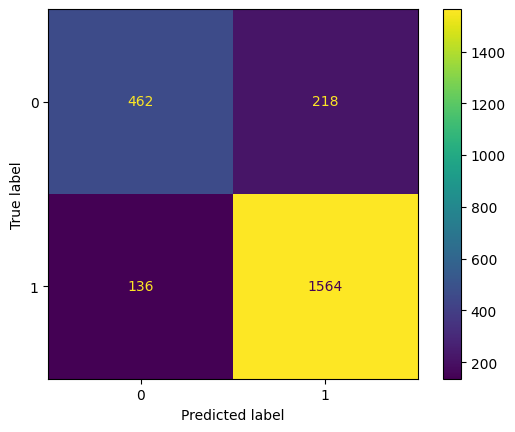

In [68]:
disp = sklearn.metrics.ConfusionMatrixDisplay(confusion_matrix=cm_log)
disp.plot()

Text(0.5, 1.0, 'Mean Error Rate for Range of K-Values')

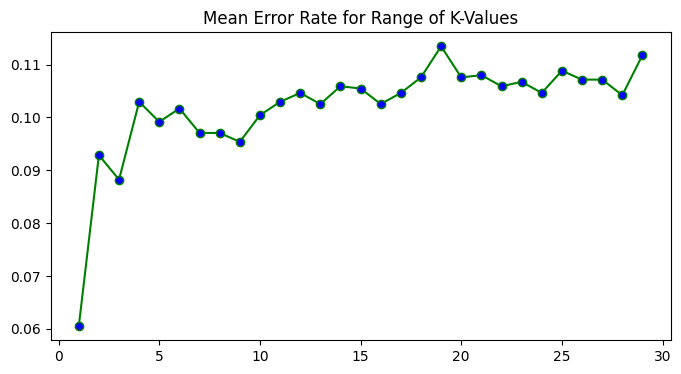

In [69]:
### Next, we try a K-Nearest Neighbour model, selecting our best k-value using the elbow method
from sklearn.neighbors import KNeighborsClassifier
err_rate = []
for i in range(1,30):
    knn = KNeighborsClassifier(n_neighbors = i)
    knn.fit(X_train.values, y_train)
    y_pred_i = knn.predict(X_test.values)
    err_rate.append(np.mean(y_pred_i != y_test))
plt.figure(figsize = (8,4))
plt.plot(range(1,30), err_rate, color = 'green', marker = 'o',markerfacecolor='blue')
plt.title('Mean Error Rate for Range of K-Values')

In [70]:
knn = KNeighborsClassifier(n_neighbors = 8)
knn.fit(X_train.values, y_train)
y_pred_knn = knn.predict(X_test.values)
cm_knn = confusion_matrix(y_test, y_pred_knn)
cr_knn = classification_report(y_test, y_pred_knn)
print(cr_knn)
print(cm_knn)

              precision    recall  f1-score   support

           0       0.81      0.86      0.84       680
           1       0.94      0.92      0.93      1700

    accuracy                           0.90      2380
   macro avg       0.88      0.89      0.88      2380
weighted avg       0.91      0.90      0.90      2380

[[ 586   94]
 [ 137 1563]]


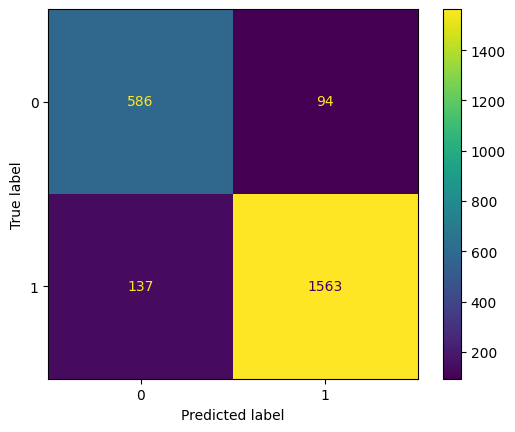

In [71]:
disp_knn = sklearn.metrics.ConfusionMatrixDisplay(confusion_matrix=cm_knn)
disp_knn.plot()

In [72]:
### Now we try with tree models
X_tree = credit_churn_dataset.drop('Attrition_Flag', axis = 1)
y_tree = credit_churn_dataset['Attrition_Flag']

In [73]:
## Drop High VIF columns
X_tree = X_tree.drop(vif_cols, axis = 1)

In [74]:
X_tree.columns

Index(['Customer_Age', 'Gender', 'Dependent_count', 'Education_Level',
       'Marital_Status', 'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio'],
      dtype='object')

In [75]:
## We need to encode the object columns using LabelEncoder
## This is similar to get_dummies
from sklearn.preprocessing import LabelEncoder
label_dict = {col: LabelEncoder() for col in dummies_col}
for col in dummies_col:
    X_tree[col] = label_dict[col].fit_transform(X_tree[col])

In [76]:
X_tree.head()

,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
CLIENTNUM,,,,,,,,,,,,,,,,
768805383,45,1,3,3,1,2,0,39,5,1,3,1.335,1144,42,1.625,0.061
818770008,49,0,5,2,2,4,0,44,6,1,2,1.541,1291,33,3.714,0.105
713982108,51,1,3,2,1,3,0,36,4,1,0,2.594,1887,20,2.333,0.000
769911858,40,0,4,3,3,4,0,34,3,4,1,1.405,1171,20,2.333,0.760
709106358,40,1,3,5,1,2,0,21,5,1,0,2.175,816,28,2.500,0.000


In [77]:
y_tree = y_tree.map(target_dict)

In [78]:
y_tree

CLIENTNUM
768805383    1
818770008    1
713982108    1
769911858    1
709106358    1
            ..
772366833    1
710638233    0
716506083    0
717406983    0
714337233    0
Name: Attrition_Flag, Length: 10127, dtype: int64

In [79]:
### Perform an oversampling on the data
oversampler = RandomOverSampler(sampling_strategy=0.4, random_state=40)
X_tree, y_tree = oversampler.fit_resample(X_tree, y_tree)

In [80]:
y_tree.value_counts()

Attrition_Flag
1    8500
0    3400
Name: count, dtype: int64

In [81]:
X_tree_train, X_tree_test, y_tree_train, y_tree_test = train_test_split(X_tree, y_tree, test_size = 0.2, random_state = 40, stratify= y_tree)
from sklearn.tree import DecisionTreeClassifier
dectree = DecisionTreeClassifier(random_state = 40)
dectree.fit(X_tree_train, y_tree_train)
y_tree_pred = dectree.predict(X_tree_test)

In [82]:
cm_dec = confusion_matrix(y_tree_test, y_tree_pred)
cr_dec = classification_report(y_tree_test, y_tree_pred)

print(cr_dec)
print(cm_dec)

              precision    recall  f1-score   support

           0       0.89      0.98      0.93       680
           1       0.99      0.95      0.97      1700

    accuracy                           0.96      2380
   macro avg       0.94      0.97      0.95      2380
weighted avg       0.96      0.96      0.96      2380

[[ 667   13]
 [  85 1615]]


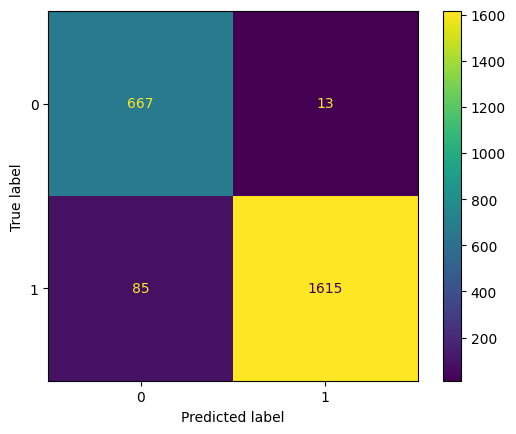

In [83]:
disp_tree = sklearn.metrics.ConfusionMatrixDisplay(confusion_matrix=cm_dec)
disp_tree.plot()

In [84]:
### The model appears to be overfitting
### Let us try to tune the hyperparameters using RandomizedSearchCV

from sklearn.model_selection import RandomizedSearchCV
def randomized_search_cv(est, params, X_train, y_train):
    random_model = RandomizedSearchCV(estimator = est, param_distributions = params, 
                                     cv = 5, n_iter = 5, random_state = 0, scoring = 'f1',
                                     return_train_score = True, verbose = 10)
    random_model.fit(X_train, y_train)
    print(f'The best params for this model is {random_model.best_params_}')
    print(f'The best score for this model is {random_model.best_score_}')
    return random_model

In [85]:
dt_params = {'max_depth':[i for i in range(3,10)],
            'min_samples_leaf':[i for i in range(10,50,10)],
            'min_samples_split':[i for i in range(10,15,65)]}
dt_random_model = randomized_search_cv(DecisionTreeClassifier(random_state=0), dt_params, X_tree_train, y_tree_train)

Fitting 5 folds for each of 5 candidates, totalling 25 fits
[CV 1/5; 1/5] START max_depth=3, min_samples_leaf=30, min_samples_split=10......
[CV 1/5; 1/5] END max_depth=3, min_samples_leaf=30, min_samples_split=10;, score=(train=0.918, test=0.918) total time=   0.0s
[CV 2/5; 1/5] START max_depth=3, min_samples_leaf=30, min_samples_split=10......
[CV 2/5; 1/5] END max_depth=3, min_samples_leaf=30, min_samples_split=10;, score=(train=0.918, test=0.914) total time=   0.0s
[CV 3/5; 1/5] START max_depth=3, min_samples_leaf=30, min_samples_split=10......
[CV 3/5; 1/5] END max_depth=3, min_samples_leaf=30, min_samples_split=10;, score=(train=0.920, test=0.911) total time=   0.0s
[CV 4/5; 1/5] START max_depth=3, min_samples_leaf=30, min_samples_split=10......
[CV 4/5; 1/5] END max_depth=3, min_samples_leaf=30, min_samples_split=10;, score=(train=0.919, test=0.918) total time=   0.0s
[CV 5/5; 1/5] START max_depth=3, min_samples_leaf=30, min_samples_split=10......
[CV 5/5; 1/5] END max_depth=3, 

[[ 590   90]
 [  91 1609]]
              precision    recall  f1-score   support

           0       0.87      0.87      0.87       680
           1       0.95      0.95      0.95      1700

    accuracy                           0.92      2380
   macro avg       0.91      0.91      0.91      2380
weighted avg       0.92      0.92      0.92      2380



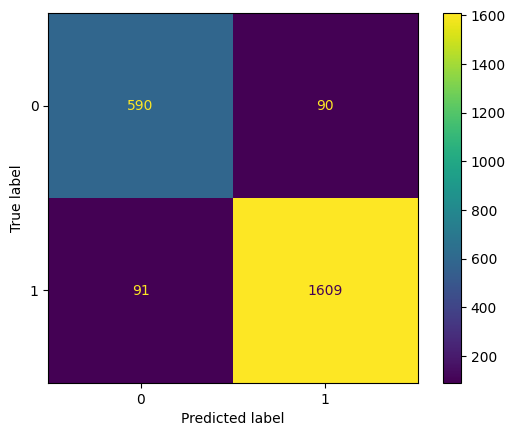

In [86]:
### Having tuned the hyperparameters, we can now pass them to the Decision tree model
dectree_tuned = DecisionTreeClassifier(**dt_random_model.best_params_)
dectree_tuned.fit(X_tree_train, y_tree_train)
y_tree_tuned_pred = dectree_tuned.predict(X_tree_test)


cm_dec_tuned = confusion_matrix(y_tree_test, y_tree_tuned_pred)
cr_dec_tuned = classification_report(y_tree_test, y_tree_tuned_pred)

print(cm_dec_tuned)
print(cr_dec_tuned)

disp_tree_tuned = sklearn.metrics.ConfusionMatrixDisplay(confusion_matrix=cm_dec_tuned)
disp_tree_tuned.plot()

In [87]:
### Random Forest Classification
from sklearn.ensemble import RandomForestClassifier
rf_class = RandomForestClassifier(random_state=40)
rf_class.fit(X_tree_train, y_tree_train)
y_pred_rf = rf_class.predict(X_tree_test)

[[ 675    5]
 [  41 1659]]
              precision    recall  f1-score   support

           0       0.94      0.99      0.97       680
           1       1.00      0.98      0.99      1700

    accuracy                           0.98      2380
   macro avg       0.97      0.98      0.98      2380
weighted avg       0.98      0.98      0.98      2380



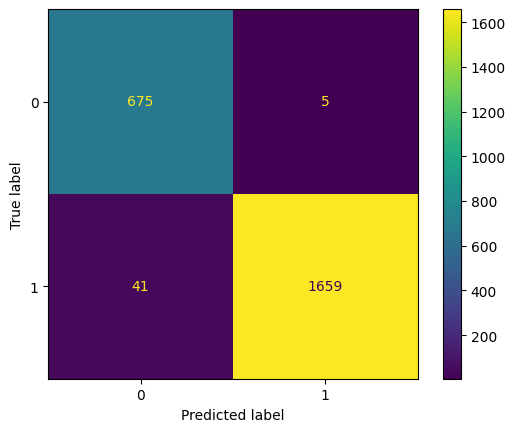

In [88]:
cm_rf = confusion_matrix(y_tree_test, y_pred_rf)
cr_rf = classification_report(y_tree_test, y_pred_rf)

print(cm_rf)
print(cr_rf)

disp_tree = sklearn.metrics.ConfusionMatrixDisplay(confusion_matrix=cm_rf)
disp_tree.plot()

In [89]:
####Hyper Parameter Tuning
rf_params={'n_estimators':[i for i in range(100,1500,200)],
           'max_depth':[i for i in range(3,10,2)],
           'min_samples_split':[i for i in range(30,100,20)],
           'min_samples_leaf':[i for i in range(30,100,30)]}
rf_randommodel= randomized_search_cv(RandomForestClassifier(random_state=40),rf_params,X_tree_train,y_tree_train)

Fitting 5 folds for each of 5 candidates, totalling 25 fits
[CV 1/5; 1/5] START max_depth=3, min_samples_leaf=60, min_samples_split=90, n_estimators=1100
[CV 1/5; 1/5] END max_depth=3, min_samples_leaf=60, min_samples_split=90, n_estimators=1100;, score=(train=0.921, test=0.916) total time=   2.5s
[CV 2/5; 1/5] START max_depth=3, min_samples_leaf=60, min_samples_split=90, n_estimators=1100
[CV 2/5; 1/5] END max_depth=3, min_samples_leaf=60, min_samples_split=90, n_estimators=1100;, score=(train=0.920, test=0.920) total time=   2.5s
[CV 3/5; 1/5] START max_depth=3, min_samples_leaf=60, min_samples_split=90, n_estimators=1100
[CV 3/5; 1/5] END max_depth=3, min_samples_leaf=60, min_samples_split=90, n_estimators=1100;, score=(train=0.923, test=0.914) total time=   2.5s
[CV 4/5; 1/5] START max_depth=3, min_samples_leaf=60, min_samples_split=90, n_estimators=1100
[CV 4/5; 1/5] END max_depth=3, min_samples_leaf=60, min_samples_split=90, n_estimators=1100;, score=(train=0.918, test=0.923) tot

[[ 591   89]
 [  55 1645]]
              precision    recall  f1-score   support

           0       0.91      0.87      0.89       680
           1       0.95      0.97      0.96      1700

    accuracy                           0.94      2380
   macro avg       0.93      0.92      0.92      2380
weighted avg       0.94      0.94      0.94      2380



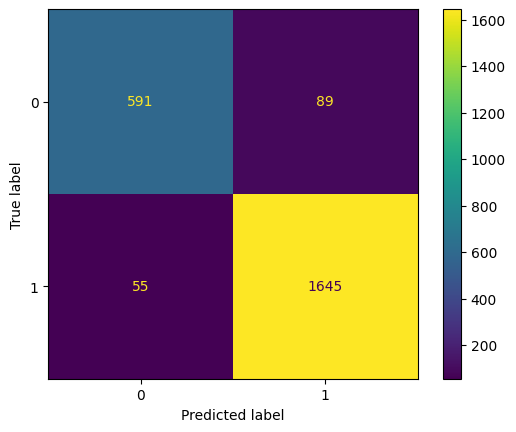

In [90]:
### Having tuned the hyperparameters, we can now pass them to the Random Forest model
rf_class_tuned = RandomForestClassifier(**rf_randommodel.best_params_, random_state= 40)
rf_class_tuned.fit(X_tree_train, y_tree_train)
y_pred_rf_tuned = rf_class_tuned.predict(X_tree_test)


cm_rf_tuned = confusion_matrix(y_tree_test, y_pred_rf_tuned)
cr_rf_tuned = classification_report(y_tree_test, y_pred_rf_tuned)

print(cm_rf_tuned)
print(cr_rf_tuned)

disp_tree_tuned = sklearn.metrics.ConfusionMatrixDisplay(confusion_matrix=cm_rf_tuned)
disp_tree_tuned.plot()

In [91]:
####Boosting Methods
###We train and test an ADABoost model and evaluate its performance
from sklearn.ensemble import AdaBoostClassifier
adaboost_clf = AdaBoostClassifier(random_state=40)
adaboost_clf.fit(X_tree_train, y_tree_train)
y_pred_ada = adaboost_clf.predict(X_tree_test)

[[ 599   81]
 [  65 1635]]
              precision    recall  f1-score   support

           0       0.90      0.88      0.89       680
           1       0.95      0.96      0.96      1700

    accuracy                           0.94      2380
   macro avg       0.93      0.92      0.92      2380
weighted avg       0.94      0.94      0.94      2380



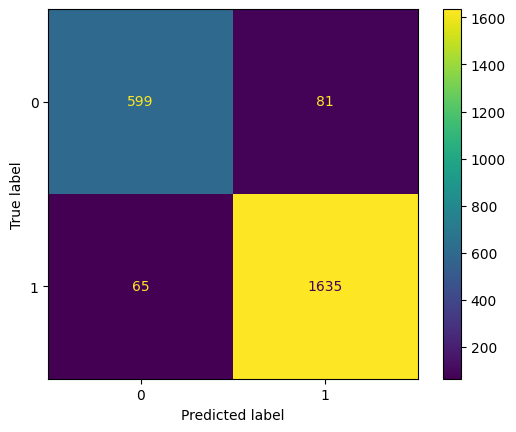

In [92]:
cm_ada = confusion_matrix(y_tree_test, y_pred_ada)
cr_ada = classification_report(y_tree_test, y_pred_ada)

print(cm_ada)
print(cr_ada)

disp_ada = sklearn.metrics.ConfusionMatrixDisplay(confusion_matrix=cm_ada)
disp_ada.plot()

In [105]:
###Hyperparameter tuning of the ADABosst
adaboost_params = {'base_estimator':[DecisionTreeClassifier(max_depth=i,random_state = 0) for i in range(3,13,2)],
                 'n_estimators':[i for i in range(10,1200,200)],
                 'learning_rate':[i for i in range(1,10)]}
adaboost_random_model = randomized_search_cv(AdaBoostClassifier(random_state = 40), adaboost_params, X_tree_train, y_tree_train)

Fitting 5 folds for each of 5 candidates, totalling 25 fits
[CV 1/5; 1/5] START base_estimator=DecisionTreeClassifier(max_depth=5, random_state=0), learning_rate=2, n_estimators=810


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 1/5; 1/5] END base_estimator=DecisionTreeClassifier(max_depth=5, random_state=0), learning_rate=2, n_estimators=810;, score=(train=0.997, test=0.977) total time=  13.5s
[CV 2/5; 1/5] START base_estimator=DecisionTreeClassifier(max_depth=5, random_state=0), learning_rate=2, n_estimators=810


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 2/5; 1/5] END base_estimator=DecisionTreeClassifier(max_depth=5, random_state=0), learning_rate=2, n_estimators=810;, score=(train=0.999, test=0.966) total time=  13.5s
[CV 3/5; 1/5] START base_estimator=DecisionTreeClassifier(max_depth=5, random_state=0), learning_rate=2, n_estimators=810


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 3/5; 1/5] END base_estimator=DecisionTreeClassifier(max_depth=5, random_state=0), learning_rate=2, n_estimators=810;, score=(train=0.998, test=0.968) total time=  13.4s
[CV 4/5; 1/5] START base_estimator=DecisionTreeClassifier(max_depth=5, random_state=0), learning_rate=2, n_estimators=810


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 4/5; 1/5] END base_estimator=DecisionTreeClassifier(max_depth=5, random_state=0), learning_rate=2, n_estimators=810;, score=(train=0.999, test=0.975) total time=  12.8s
[CV 5/5; 1/5] START base_estimator=DecisionTreeClassifier(max_depth=5, random_state=0), learning_rate=2, n_estimators=810


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 5/5; 1/5] END base_estimator=DecisionTreeClassifier(max_depth=5, random_state=0), learning_rate=2, n_estimators=810;, score=(train=0.990, test=0.962) total time=  13.2s
[CV 1/5; 2/5] START base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=5, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 1/5; 2/5] END base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=5, n_estimators=610;, score=(train=0.892, test=0.879) total time=  13.0s
[CV 2/5; 2/5] START base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=5, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 2/5; 2/5] END base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=5, n_estimators=610;, score=(train=0.946, test=0.937) total time=  13.9s
[CV 3/5; 2/5] START base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=5, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 3/5; 2/5] END base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=5, n_estimators=610;, score=(train=0.972, test=0.952) total time=  13.8s
[CV 4/5; 2/5] START base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=5, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 4/5; 2/5] END base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=5, n_estimators=610;, score=(train=0.968, test=0.959) total time=  13.9s
[CV 5/5; 2/5] START base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=5, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 5/5; 2/5] END base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=5, n_estimators=610;, score=(train=0.947, test=0.937) total time=  13.2s
[CV 1/5; 3/5] START base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=8, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 1/5; 3/5] END base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=8, n_estimators=610;, score=(train=0.878, test=0.870) total time=  14.1s
[CV 2/5; 3/5] START base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=8, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 2/5; 3/5] END base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=8, n_estimators=610;, score=(train=0.884, test=0.876) total time=  13.9s
[CV 3/5; 3/5] START base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=8, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 3/5; 3/5] END base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=8, n_estimators=610;, score=(train=0.910, test=0.901) total time=  14.1s
[CV 4/5; 3/5] START base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=8, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 4/5; 3/5] END base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=8, n_estimators=610;, score=(train=0.893, test=0.885) total time=  13.6s
[CV 5/5; 3/5] START base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=8, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 5/5; 3/5] END base_estimator=DecisionTreeClassifier(max_depth=7, random_state=0), learning_rate=8, n_estimators=610;, score=(train=0.942, test=0.927) total time=  13.9s
[CV 1/5; 4/5] START base_estimator=DecisionTreeClassifier(max_depth=9, random_state=0), learning_rate=5, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 1/5; 4/5] END base_estimator=DecisionTreeClassifier(max_depth=9, random_state=0), learning_rate=5, n_estimators=610;, score=(train=0.945, test=0.918) total time=  16.3s
[CV 2/5; 4/5] START base_estimator=DecisionTreeClassifier(max_depth=9, random_state=0), learning_rate=5, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 2/5; 4/5] END base_estimator=DecisionTreeClassifier(max_depth=9, random_state=0), learning_rate=5, n_estimators=610;, score=(train=0.960, test=0.948) total time=  16.2s
[CV 3/5; 4/5] START base_estimator=DecisionTreeClassifier(max_depth=9, random_state=0), learning_rate=5, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 3/5; 4/5] END base_estimator=DecisionTreeClassifier(max_depth=9, random_state=0), learning_rate=5, n_estimators=610;, score=(train=0.974, test=0.953) total time=  16.9s
[CV 4/5; 4/5] START base_estimator=DecisionTreeClassifier(max_depth=9, random_state=0), learning_rate=5, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 4/5; 4/5] END base_estimator=DecisionTreeClassifier(max_depth=9, random_state=0), learning_rate=5, n_estimators=610;, score=(train=0.969, test=0.953) total time=  16.8s
[CV 5/5; 4/5] START base_estimator=DecisionTreeClassifier(max_depth=9, random_state=0), learning_rate=5, n_estimators=610


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 5/5; 4/5] END base_estimator=DecisionTreeClassifier(max_depth=9, random_state=0), learning_rate=5, n_estimators=610;, score=(train=0.971, test=0.941) total time=  17.6s
[CV 1/5; 5/5] START base_estimator=DecisionTreeClassifier(max_depth=11, random_state=0), learning_rate=7, n_estimators=210


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 1/5; 5/5] END base_estimator=DecisionTreeClassifier(max_depth=11, random_state=0), learning_rate=7, n_estimators=210;, score=(train=0.988, test=0.963) total time=   6.2s
[CV 2/5; 5/5] START base_estimator=DecisionTreeClassifier(max_depth=11, random_state=0), learning_rate=7, n_estimators=210


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 2/5; 5/5] END base_estimator=DecisionTreeClassifier(max_depth=11, random_state=0), learning_rate=7, n_estimators=210;, score=(train=0.929, test=0.916) total time=   6.5s
[CV 3/5; 5/5] START base_estimator=DecisionTreeClassifier(max_depth=11, random_state=0), learning_rate=7, n_estimators=210


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 3/5; 5/5] END base_estimator=DecisionTreeClassifier(max_depth=11, random_state=0), learning_rate=7, n_estimators=210;, score=(train=0.926, test=0.905) total time=   6.6s
[CV 4/5; 5/5] START base_estimator=DecisionTreeClassifier(max_depth=11, random_state=0), learning_rate=7, n_estimators=210


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 4/5; 5/5] END base_estimator=DecisionTreeClassifier(max_depth=11, random_state=0), learning_rate=7, n_estimators=210;, score=(train=0.997, test=0.974) total time=   6.3s
[CV 5/5; 5/5] START base_estimator=DecisionTreeClassifier(max_depth=11, random_state=0), learning_rate=7, n_estimators=210


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[CV 5/5; 5/5] END base_estimator=DecisionTreeClassifier(max_depth=11, random_state=0), learning_rate=7, n_estimators=210;, score=(train=0.983, test=0.964) total time=   6.4s


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


The best params for this model is {'n_estimators': 810, 'learning_rate': 2, 'base_estimator': DecisionTreeClassifier(max_depth=5, random_state=0)}
The best score for this model is 0.9697747164886834


/opt/homebrew/lib/python3.11/site-packages/sklearn/ensemble/_base.py:156: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(


[[ 661   19]
 [  48 1652]]
              precision    recall  f1-score   support

           0       0.93      0.97      0.95       680
           1       0.99      0.97      0.98      1700

    accuracy                           0.97      2380
   macro avg       0.96      0.97      0.97      2380
weighted avg       0.97      0.97      0.97      2380



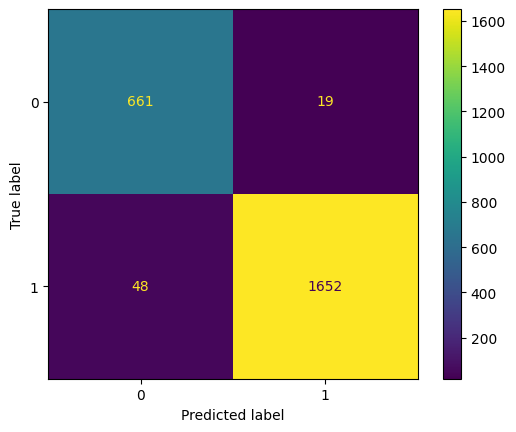

In [94]:
### Having tuned the hyperparameters, we can now pass them to the Ada Boost model
adaboost_clf_tuned = AdaBoostClassifier(random_state = 40,**adaboost_random_model.best_params_)
adaboost_clf_tuned.fit(X_tree_train, y_tree_train)
y_pred_ada_tuned = adaboost_clf_tuned.predict(X_tree_test)


cm_ada_tuned = confusion_matrix(y_tree_test, y_pred_ada_tuned)
cr_ada_tuned = classification_report(y_tree_test, y_pred_ada_tuned)

print(cm_ada_tuned)
print(cr_ada_tuned)

disp_ada_tuned = sklearn.metrics.ConfusionMatrixDisplay(confusion_matrix=cm_ada_tuned)
disp_ada_tuned.plot()

In [95]:
!pip install xgboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 3.0 MB/s eta 0:00:0000:0100:01

[notice] A new release of pip is available: 23.3.1 -> 23.3.2
[notice] To update, run: python3.11 -m pip install --upgrade pip


In [97]:
from xgboost import XGBClassifier
xgb_clf = XGBClassifier(random_state=40)
xgb_clf.fit(X_tree_train, y_tree_train)
y_pred_xgb = xgb_clf.predict(X_tree_test)

[[ 676    4]
 [  32 1668]]
              precision    recall  f1-score   support

           0       0.95      0.99      0.97       680
           1       1.00      0.98      0.99      1700

    accuracy                           0.98      2380
   macro avg       0.98      0.99      0.98      2380
weighted avg       0.99      0.98      0.98      2380



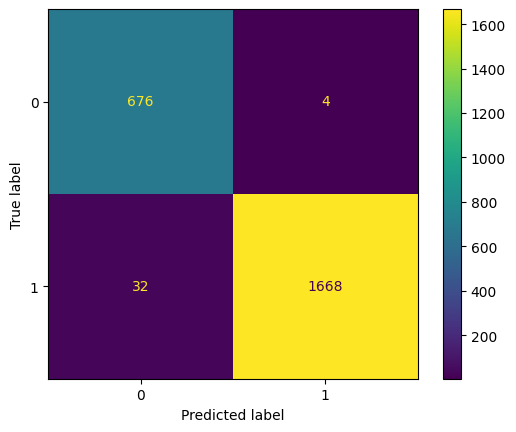

In [98]:
cm_xgb = confusion_matrix(y_tree_test, y_pred_xgb)
cr_xgb = classification_report(y_tree_test, y_pred_xgb)

print(cm_xgb)
print(cr_xgb)

disp_xgb = sklearn.metrics.ConfusionMatrixDisplay(confusion_matrix=cm_xgb)
disp_xgb.plot()

In [106]:
###Hyperparameter tuning of the XGBosst
import scipy.stats as stats
xgboost_params = {
    'max_depth': stats.randint(3, 10),
    'learning_rate': stats.uniform(0.01, 0.1),
    'subsample': stats.uniform(0.5, 0.5),
    'n_estimators':stats.randint(50, 200)
}
xgboost_random_model = randomized_search_cv(XGBClassifier(random_state=40), xgboost_params, X_tree_train, y_tree_train)

Fitting 5 folds for each of 5 candidates, totalling 25 fits
[CV 1/5; 1/5] START learning_rate=0.06488135039273248, max_depth=8, n_estimators=117, subsample=0.9289728088113784
[CV 1/5; 1/5] END learning_rate=0.06488135039273248, max_depth=8, n_estimators=117, subsample=0.9289728088113784;, score=(train=0.998, test=0.978) total time=   0.8s
[CV 2/5; 1/5] START learning_rate=0.06488135039273248, max_depth=8, n_estimators=117, subsample=0.9289728088113784
[CV 2/5; 1/5] END learning_rate=0.06488135039273248, max_depth=8, n_estimators=117, subsample=0.9289728088113784;, score=(train=0.998, test=0.977) total time=   0.6s
[CV 3/5; 1/5] START learning_rate=0.06488135039273248, max_depth=8, n_estimators=117, subsample=0.9289728088113784
[CV 3/5; 1/5] END learning_rate=0.06488135039273248, max_depth=8, n_estimators=117, subsample=0.9289728088113784;, score=(train=0.998, test=0.979) total time=   0.6s
[CV 4/5; 1/5] START learning_rate=0.06488135039273248, max_depth=8, n_estimators=117, subsample=0

[[ 674    6]
 [  38 1662]]
              precision    recall  f1-score   support

           0       0.95      0.99      0.97       680
           1       1.00      0.98      0.99      1700

    accuracy                           0.98      2380
   macro avg       0.97      0.98      0.98      2380
weighted avg       0.98      0.98      0.98      2380



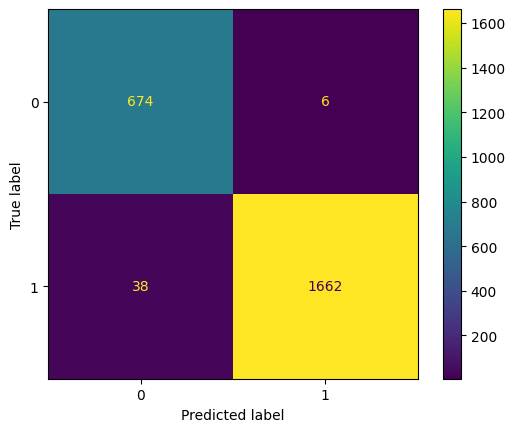

In [107]:
### Having tuned the hyperparameters, we can now pass them to the XGBoost model
xgboost_clf_tuned = XGBClassifier(random_state = 40,**xgboost_random_model.best_params_)
xgboost_clf_tuned.fit(X_tree_train, y_tree_train)
y_pred_xgb_tuned = xgboost_clf_tuned.predict(X_tree_test)


cm_xgb_tuned = confusion_matrix(y_tree_test, y_pred_xgb_tuned)
cr_xgb_tuned = classification_report(y_tree_test, y_pred_xgb_tuned)

print(cm_xgb_tuned)
print(cr_xgb_tuned)

disp_xgb_tuned = sklearn.metrics.ConfusionMatrixDisplay(confusion_matrix=cm_xgb_tuned)
disp_xgb_tuned.plot()